# Setup

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from sklearn.preprocessing import MinMaxScaler
import torch

from tqdm import tqdm

import math
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.nn.modules import MultiheadAttention, Linear, Dropout, BatchNorm1d, TransformerEncoderLayer

upstream_imputation_path = '/Users/davidharar/Documents/School/thesis/upstream_seq2seq/'
downstream_classification_path = '/Users/davidharar/Documents/School/thesis/downstream_classification'
os.chdir(downstream_classification_path)
from dataloader.DataLoader import SHL_DataGenerator_for_imputation
os.chdir(upstream_imputation_path)

shl_data_generator = SHL_DataGenerator_for_imputation(
    metadata_file_path = f'{downstream_classification_path}/data/combined_data/metadata_only_existant_readings_09042023.csv',
    data_folder_path = f'{downstream_classification_path}/data/individual-signals/',
    batch_size=4,
    fillna=0,
)

X,signal_names = shl_data_generator.__getitem__(1224)
print(X.shape, signal_names.shape)
X,signal_names

(4, 12, 450) (4,)


(array([[[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ]],
 
        [[0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        , ..., 0.        ,
          0.        , 0.

In [2]:
from modeling.Transformer import TSTransformerEncoder
import torch

input_dimension          = 12
output_dimension         = 12
hidden_dimmension        = 64
attention_heads          = None
decoder_number_of_layers = 8
positional_encodings     = False
dropout                  = 0.4
device                   = 'mps'
model = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model.load_state_dict(torch.load('./models/exp4-base-version-with-train-by-sample-window-450.pt'))
print(model)

64 1
TSTransformerEncoder(
  (project_input): Linear(in_features=12, out_features=64, bias=True)
  (encoder): Linear(in_features=12, out_features=64, bias=True)
  (pos_encoder): PositionalEncoding(
    (dropout): Dropout(p=0.4, inplace=False)
  )
  (transformer_encoder): TransformerEncoder(
    (layers): ModuleList(
      (0-7): 8 x TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): NonDynamicallyQuantizableLinear(in_features=64, out_features=64, bias=True)
        )
        (linear1): Linear(in_features=64, out_features=512, bias=True)
        (dropout): Dropout(p=0.4, inplace=False)
        (linear2): Linear(in_features=512, out_features=64, bias=True)
        (norm1): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((64,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.4, inplace=False)
        (dropout2): Dropout(p=0.4, inplace=False)
      )
    )
  )
  (output_layer): Linear(in_features=64, o

/opt/homebrew/Caskroom/miniforge/base/envs/torch-gpu/lib/python3.8/site-packages/torch/nn/modules/transformer.py:218: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because  self.layers[0].self_attn.batch_first was not True
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


64 1


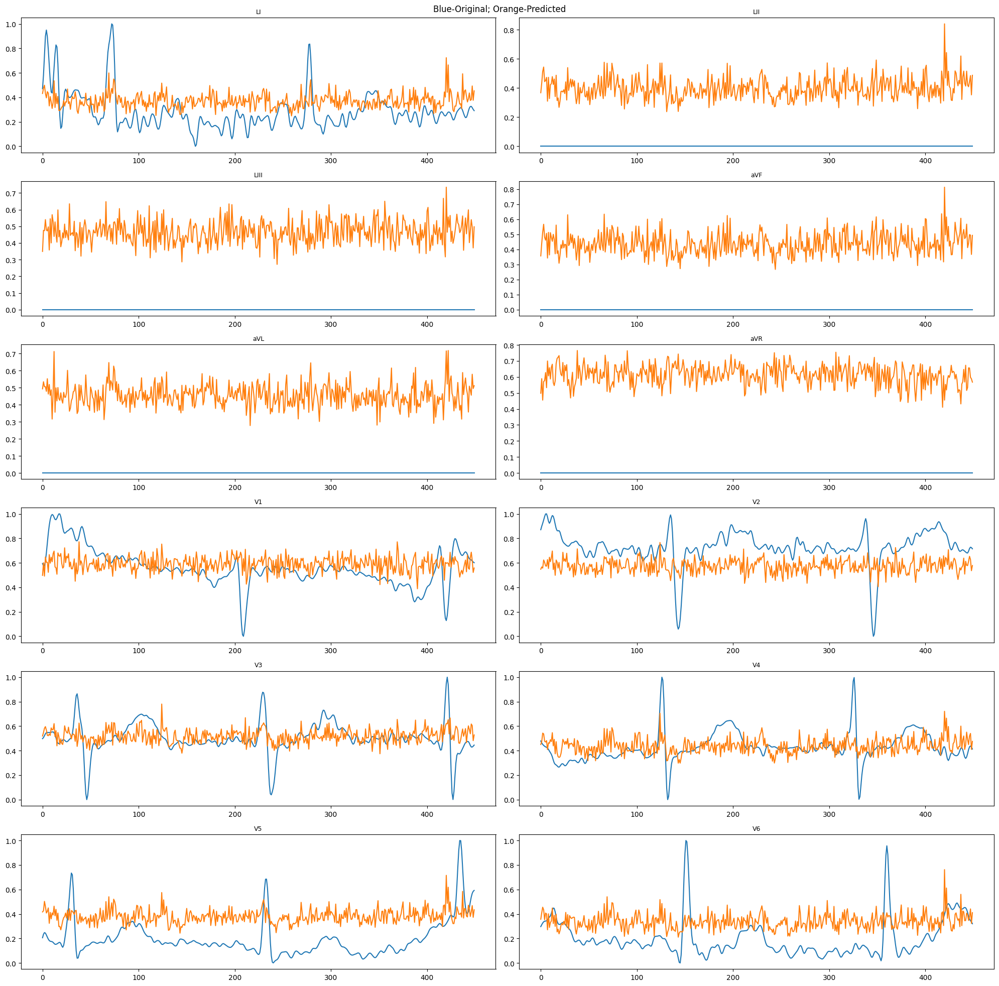

64 1


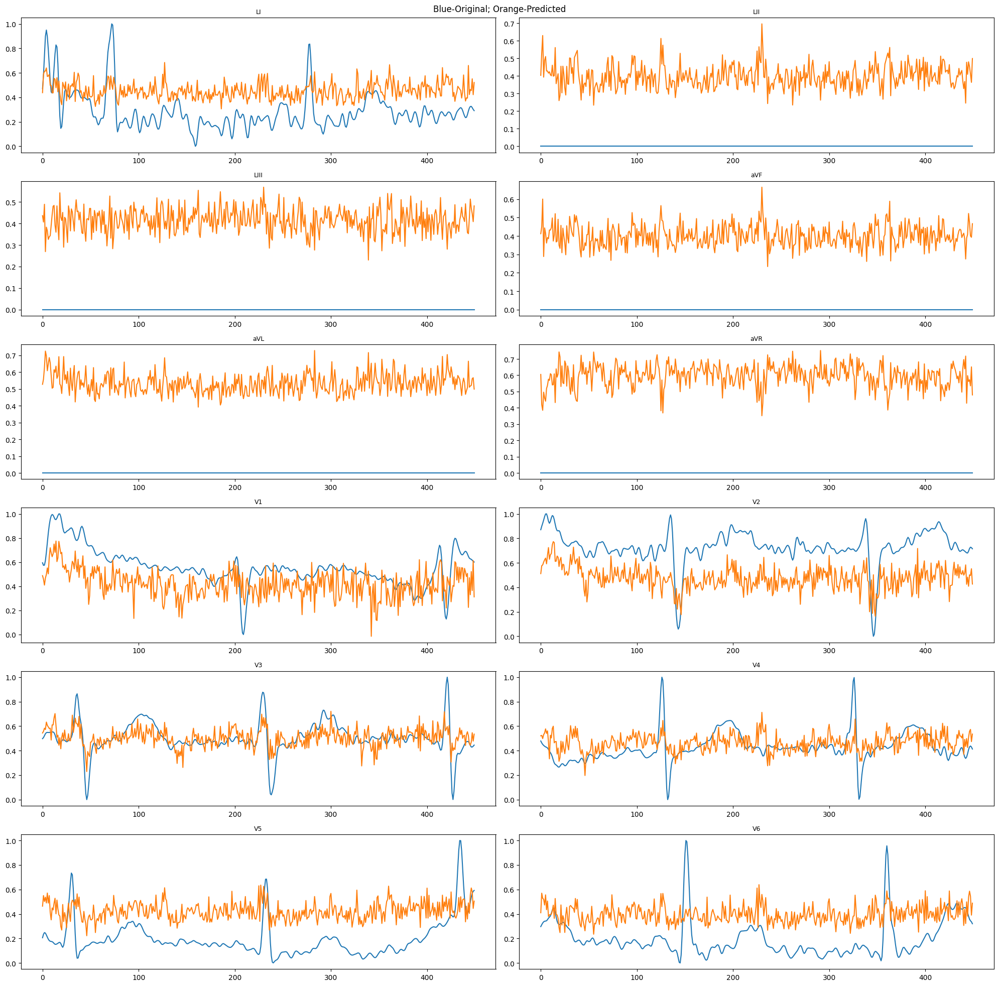

64 1


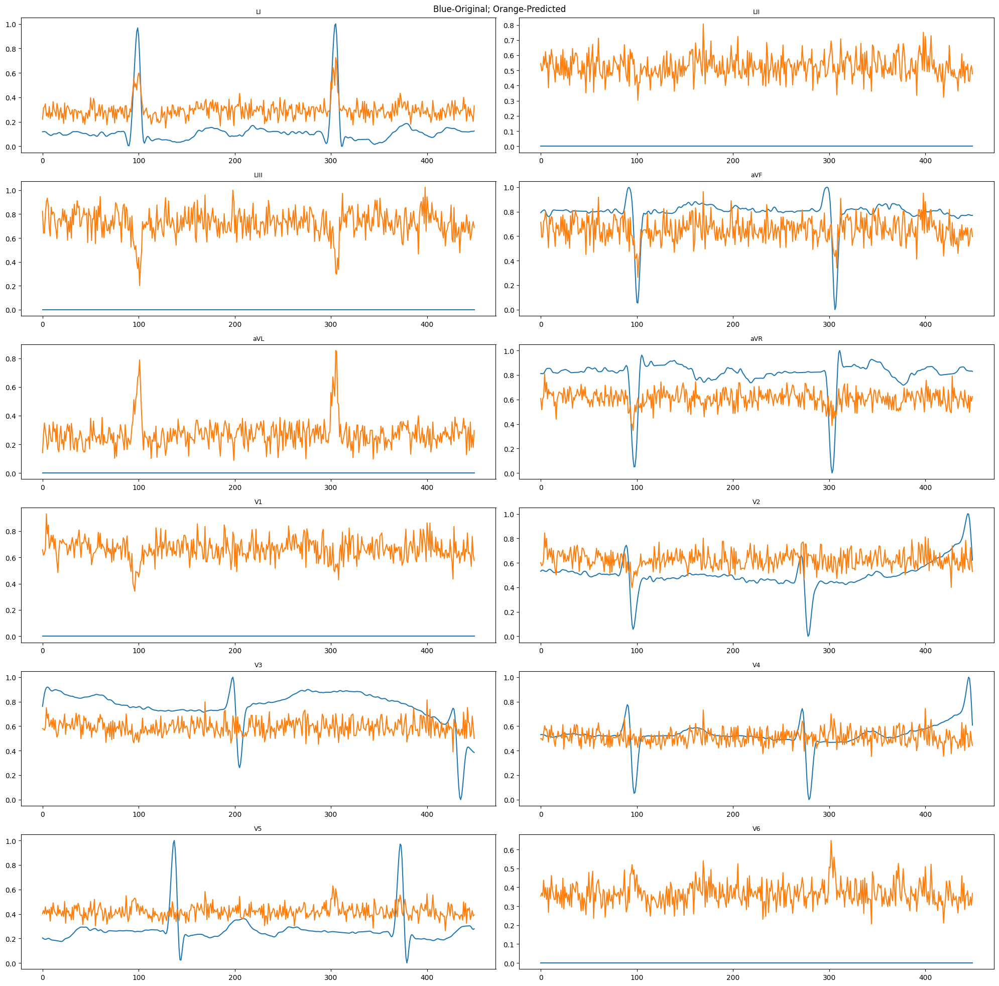

64 1


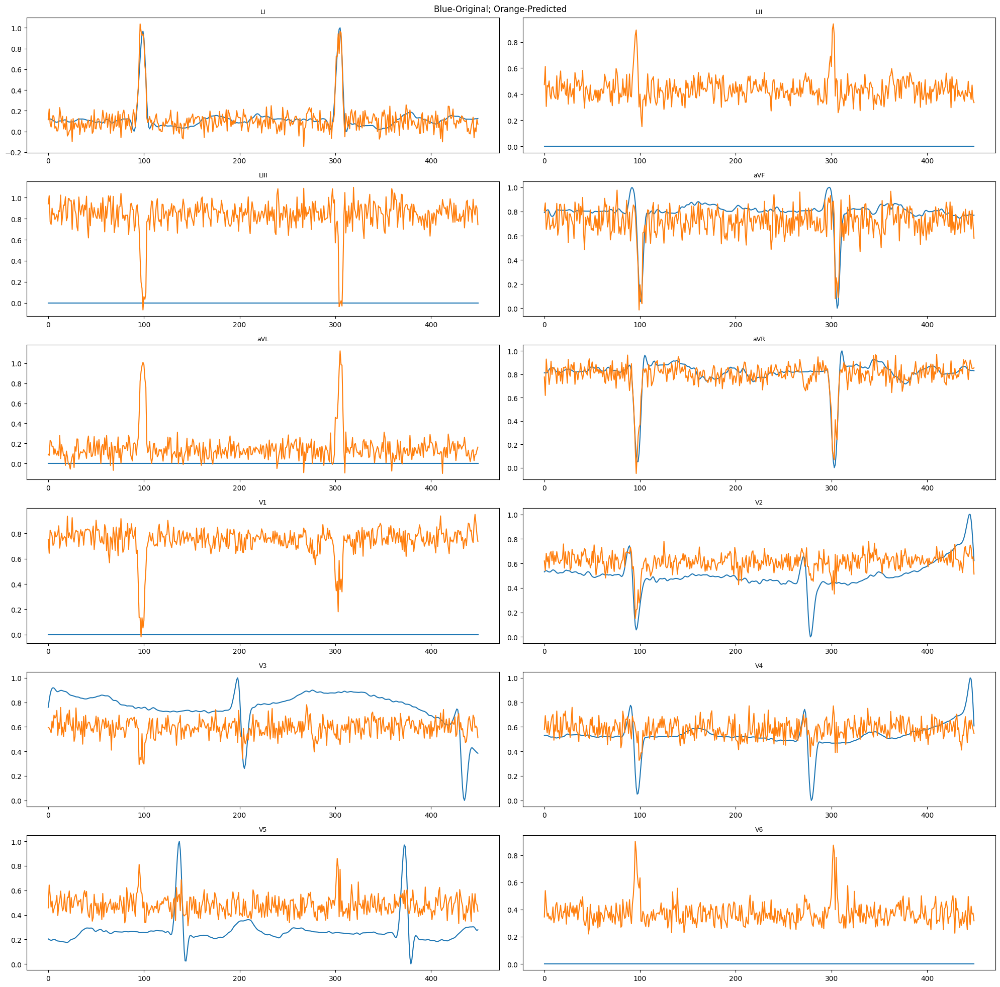

64 1


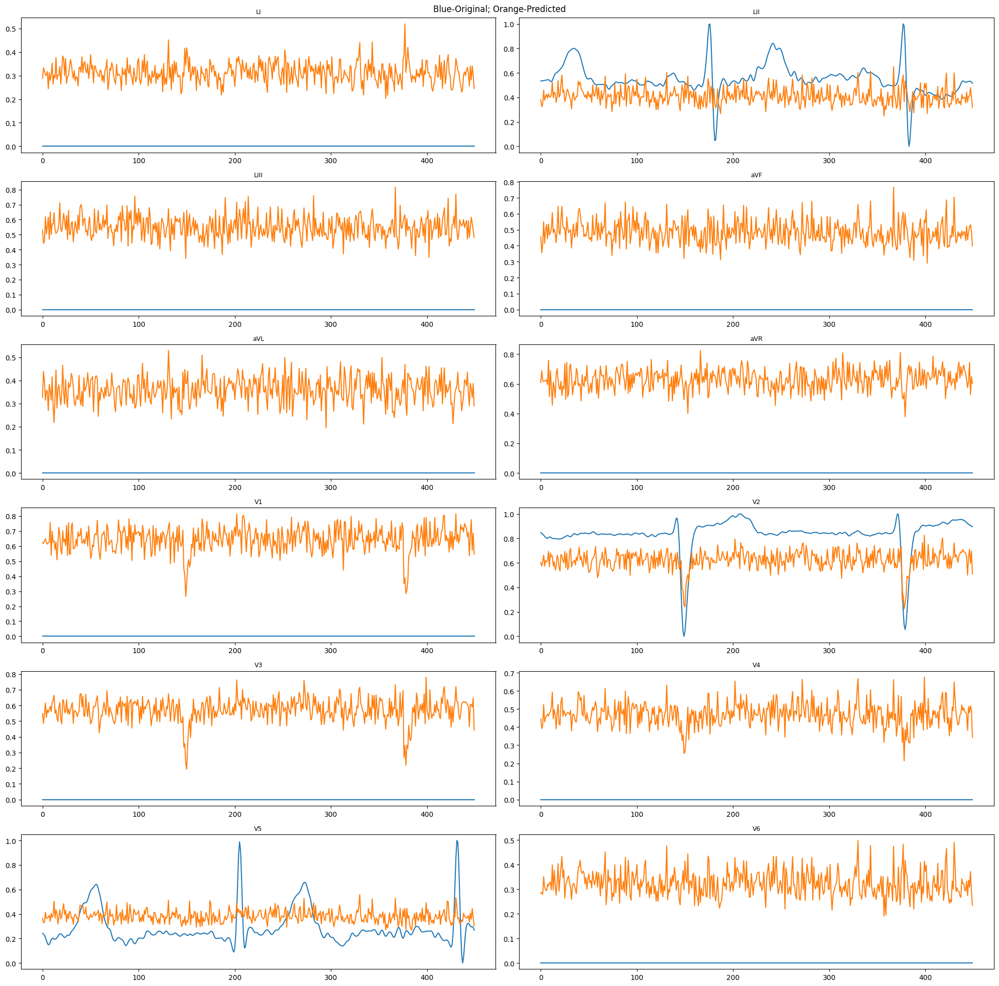

64 1


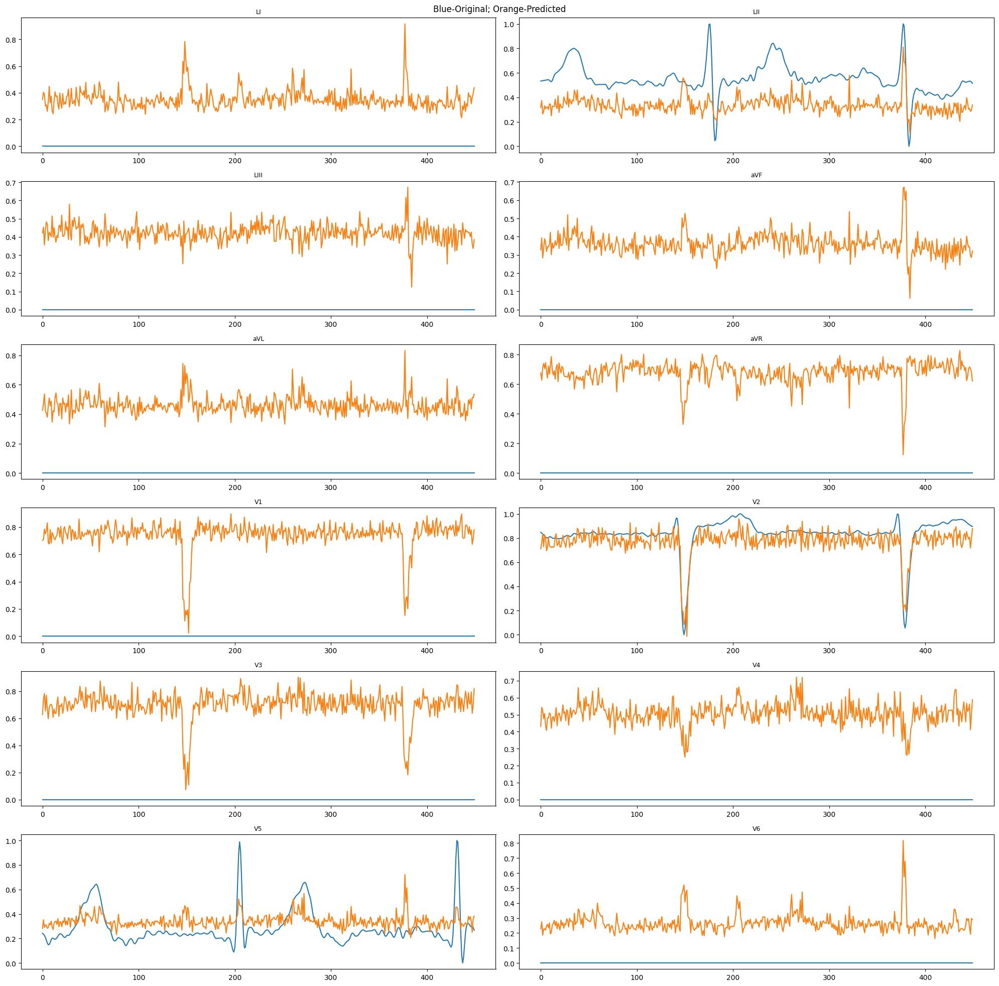

In [28]:
MODEL_NAME = 'exp4-base-version-with-train-by-sample-window-450.pt'
MODEL_NAME2 = 'exp4-base-version-with-train-by-sample-window-450_1695652345.7981088.pt'

def plot_12_signals_of_three_sources(reading, predicted, plot_saving_path):
    """
    plot a 12 electrodes reading of before/after. For example, before and after corruption,
    and actutal vs. predicted.
    """
    fig, axs = plt.subplots(6, 2, figsize = (20,20))

    leads = ['LI', 'LII', 'LIII', 'aVF', 'aVL', 'aVR','V1','V2','V3','V4','V5','V6']
    s=0
    for ax in axs.flat:
        ax.plot(reading[s])
        ax.plot(predicted[s])
        ax.set_title(leads[s],fontsize=9)
        s+=1
    fig.suptitle('Blue-Original; Orange-Predicted')
    plt.tight_layout()
    if plot_saving_path:
        plt.savefig(f'{plot_saving_path}.png')
    plt.show()
    
def plot_signal(src_, model_name):

    
    from modeling.Transformer import TSTransformerEncoder
    import torch

    input_dimension          = 12
    output_dimension         = 12
    hidden_dimmension        = 64
    attention_heads          = None
    decoder_number_of_layers = 8
    positional_encodings     = False
    dropout                  = 0.4
    device                   = 'mps'
    model_1 = TSTransformerEncoder(input_dimension, output_dimension, 
                        hidden_dimmension, attention_heads, 
                        decoder_number_of_layers, positional_encodings,dropout).to(device)
    model_1.load_state_dict(torch.load(f'{upstream_imputation_path}/models/{model_name}'))
    
    # data corruption
    # src_ = data_corruptor.corrupt_a_batch(src_)

    # fix shapes ( -> [length, batch_size, channels])
    src_ = np.float32(np.transpose(src_, axes=(2,0,1)))

    # move to gpu so we can pass through model
    src_ = torch.from_numpy(src_).to(device)

    # choose which signal from the first batch to look at
    # sig_to_plot = np.random.randint(0,src_.shape[0],1)
    sig_to_plot = 0

    with torch.no_grad():
        y_pred = model_1(src_,None).cpu().numpy()

    # prep signals for presentation
    corrupted = np.squeeze(src_[:,sig_to_plot,:].cpu().numpy()).T
    reconstructed = np.squeeze(y_pred[:,sig_to_plot,:]).T

    plot_12_signals_of_three_sources(corrupted,reconstructed, None)

for _ in range(3):
    S = np.random.randint(0,1000,1)[0]
    X,signal_names = shl_data_generator.__getitem__(S)
    plot_signal(X, model_name = MODEL_NAME)
    plot_signal(X, model_name = MODEL_NAME2)
    

# Get and Analyze MSE
To ensure maximum flexability, we return 12 MSEs for each of the leads, 12 values for each reading.

In [156]:
# hyperparams:
model_name = 'exp4-base-version-with-train-by-sample-window-450_1695652345.7981088.pt'
model_name_for_saving = model_name.replace('.pt','')
# --------------

from modeling.Transformer import TSTransformerEncoder
import torch

input_dimension          = 12
output_dimension         = 12
hidden_dimmension        = 64
attention_heads          = None
decoder_number_of_layers = 8
positional_encodings     = False
dropout                  = 0.4
device                   = 'mps'
model = TSTransformerEncoder(input_dimension, output_dimension, 
                    hidden_dimmension, attention_heads, 
                    decoder_number_of_layers, positional_encodings,dropout).to(device)
model.load_state_dict(torch.load(f'{upstream_imputation_path}/models/{model_name}'))


def get_MSE(src_, model):
    model.eval()
    # data corruption
    # src_ = data_corruptor.corrupt_a_batch(src_)

    # fix shapes ( -> [length, batch_size, channels])
    src_ = np.float32(np.transpose(src_, axes=(2,0,1)))

    # move to gpu so we can pass through model
    src_ = torch.from_numpy(src_).to(device)

    # choose which signal from the first batch to look at
    # sig_to_plot = np.random.randint(0,src_.shape[0],1)

    with torch.no_grad():
        y_pred = model(src_,None).cpu().numpy()
    
    src_ = src_.cpu().numpy()
    
    src_ = np.transpose(src_, axes=(1,2,0))    
    y_pred = np.transpose(y_pred, axes=(1,2,0))    
    mse = np.mean(src_-y_pred,axis=-1)

    return mse

def get_non_zero_leads(X):
    means = np.mean(X,axis=-1) != 0
    return means

def get_mse_for_batch(mse, zeros_mask):
    return [np.mean(mse[j,:][zeros_mask[j,:]])**2 for j in range(mse.shape[0])]

def get_number_of_empty_leads(X):
    sums = np.sum(np.mean(X,axis=-1) == 0,axis=-1)
    return sums


X,signal_names = shl_data_generator.__getitem__(1)
mse = get_MSE(X,model)
non_zeros_mask = get_non_zero_leads(X)
print('sigmals:', signal_names)
print('MSE:', get_mse_for_batch(mse,non_zeros_mask))



64 1


/opt/homebrew/Caskroom/miniforge/base/envs/torch-gpu/lib/python3.8/site-packages/torch/nn/modules/transformer.py:218: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because  self.layers[0].self_attn.batch_first was not True
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


sigmals: [ 11623 412684  48556 295230 444556 275995 466142 519287 523624 464459
 343083 334440 523413 208170 255213 221841 538068 455181  11380 352776
 402933 446901 298586 448116 380424 241567 145751 334904 428181 172275
  17616  12352 533398 548333 314563  11479 156713 490278 137018  34214
 367446 294396 456618 350269 100464 155144 502437 208590 312295 308113
  42679 541975 229507 498090 272920 284714 496291 310810 258460   2969
 456197 271839 339440 368232 501200 241110 405302 441569 438586 322018
   4995 217165 446307 295222 139639 187820 418038 204230 497848 435217
 373823 475548 423738  28757  35492 129297 113103 498160 512107 457573
 234891 261890 381787 101077 433622 346960  33441 189401 280914 411369
 413898 411256 254791  44429 490211 466040 390794 213764 393611 285017
 344054 326512 544656 328091 331286 480938 383373 139212 128447 348729
 367886 511557  25262 330274 141055  36766 516959 285977 378722 251362
 466862 208559 416811 126309 205908 117616 375809 525057 434854 2274

In [159]:
shl_data_generator = SHL_DataGenerator_for_imputation(
    metadata_file_path = f'{downstream_classification_path}/data/combined_data/metadata_only_existant_readings_09042023.csv',
    data_folder_path = f'{downstream_classification_path}/data/individual-signals/',
    batch_size=512,
    fillna=0,
)

indices = 0
signals = []
mses = []
empty_leads = []
for j in tqdm(range(shl_data_generator.__len__())):
    # load data
    X,signal_names = shl_data_generator.__getitem__(j)
    
    # calculate MSE
    mse = get_MSE(X,model)
    zeros_mask = get_non_zero_leads(X)
    mses_batch = get_mse_for_batch(mse,zeros_mask)
    
    # calc empty leads
    empty_leads_batch = get_number_of_empty_leads(X)


    signals += signal_names.tolist()
    mses += mses_batch
    empty_leads += empty_leads_batch.tolist()

signals_and_MSEs = pd.DataFrame({'signal':signals, 'mse': mses, 'empty_leads': empty_leads})
# signals_and_MSEs.to_csv(f'./summary_stats_and_tables/MSE_on_non_empty_leads_{model_name_for_saving}.csv')
signals_and_MSEs

100%|██████████| 725/725 [26:10<00:00,  2.17s/it]


,signal,mse,empty_leads
0,427805,0.002066,2
1,356921,0.000153,11
2,428248,0.000089,4
3,440621,0.002889,9
4,32229,0.001601,2
...,...,...,...
371195,134102,0.010353,11
371196,307229,0.000010,10
371197,141798,0.000011,8
371198,529420,0.000468,0


## MSE Boxplot

<Axes: xlabel='empty_leads', ylabel='mse'>

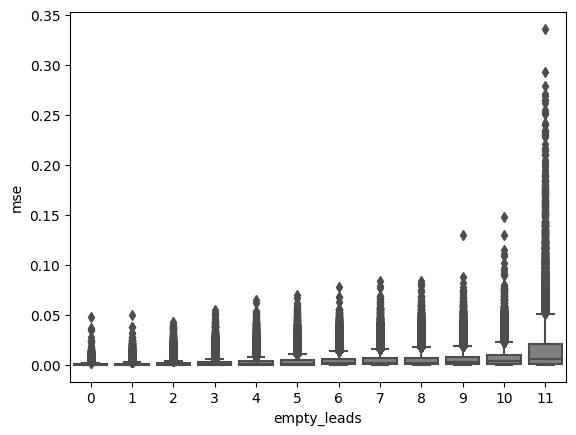

In [160]:
import seaborn as sns
sns.boxplot(data = signals_and_MSEs, x = 'empty_leads', y='mse', color='gray')

## Look qualitatively on best and worst

In [163]:
signals_and_MSEs.sort_values('mse')['signal'][:10]

252520    235857
132710    442154
361426    389759
92863     201389
253594    402529
258947    274703
184256    508080
162380    458520
24530     103531
131645    544529
Name: signal, dtype: int64

64 1


/opt/homebrew/Caskroom/miniforge/base/envs/torch-gpu/lib/python3.8/site-packages/torch/nn/modules/transformer.py:218: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because  self.layers[0].self_attn.batch_first was not True
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


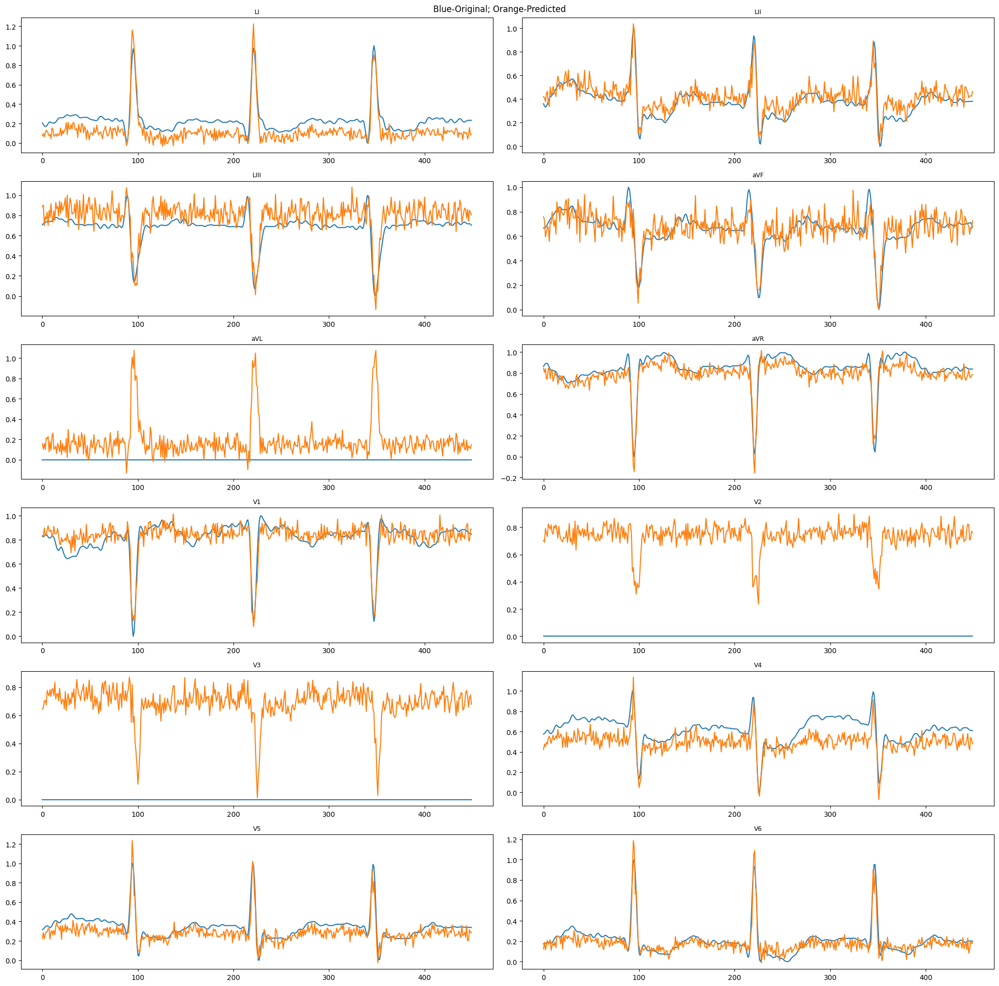

64 1


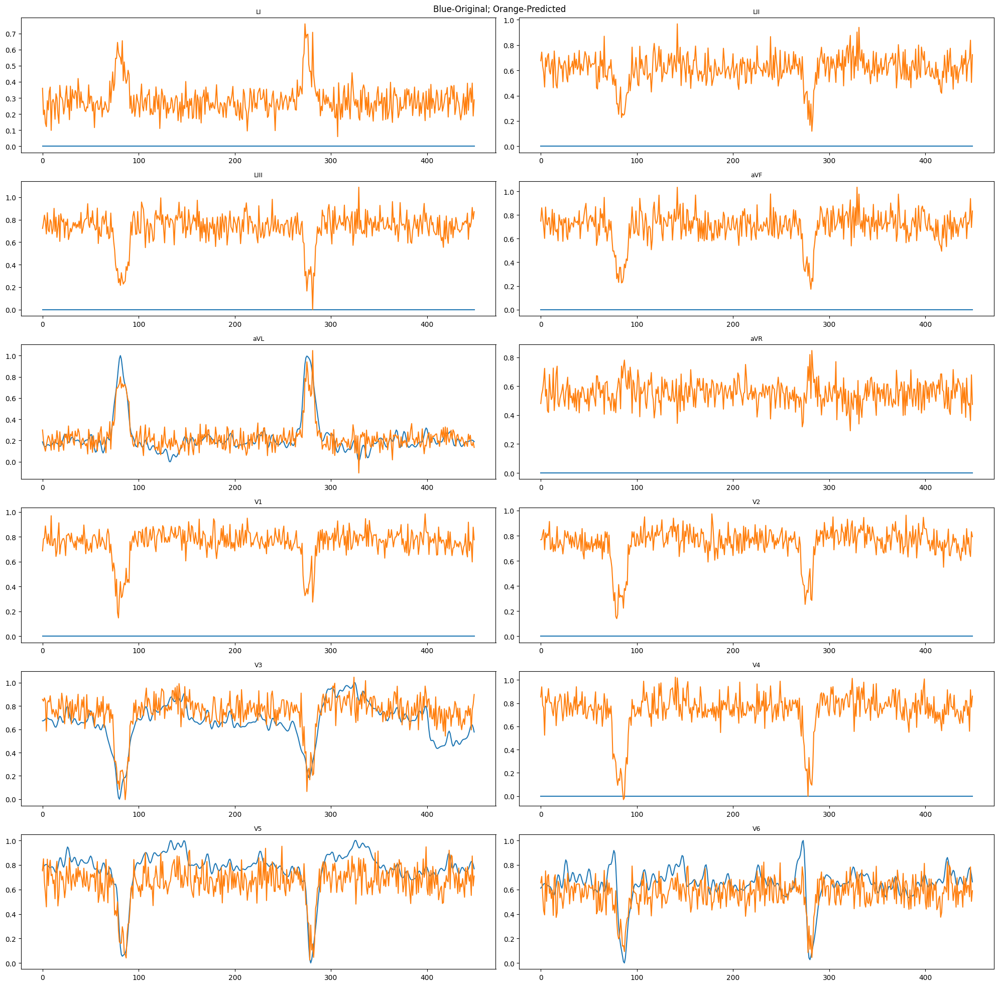

64 1


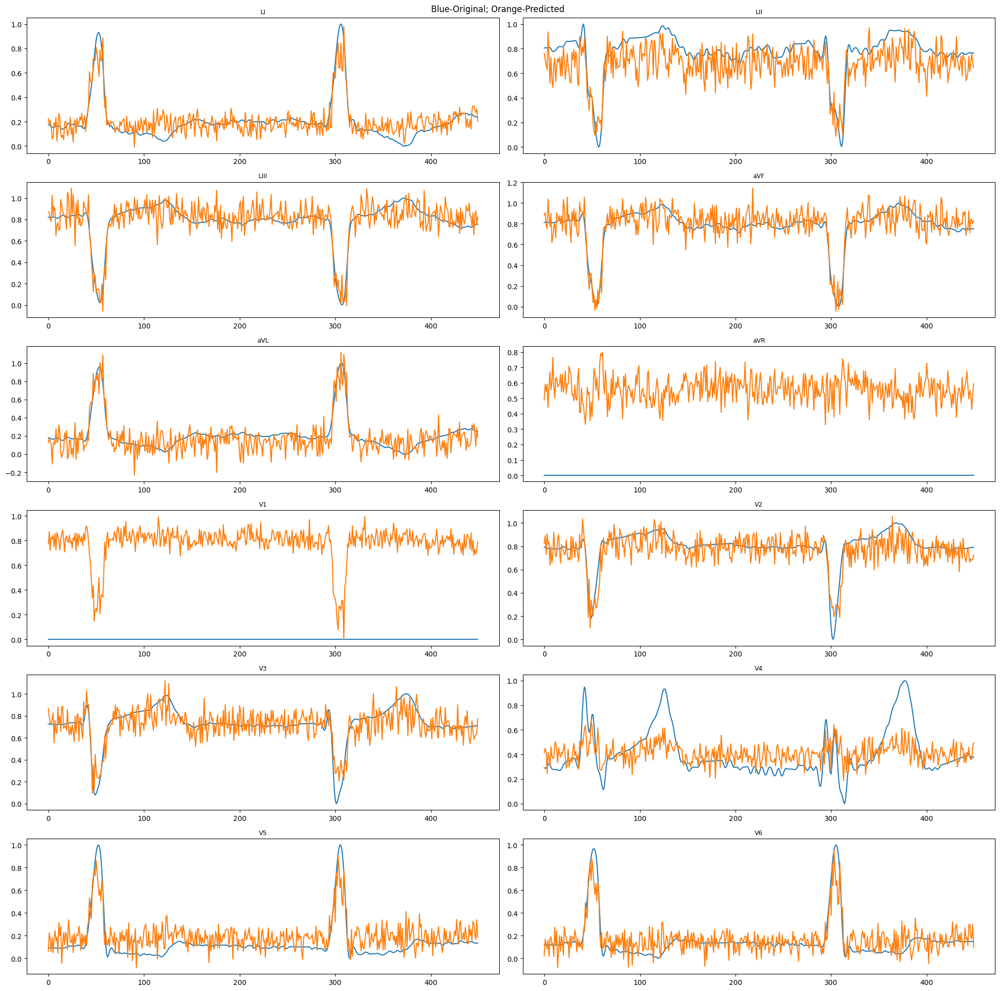

64 1


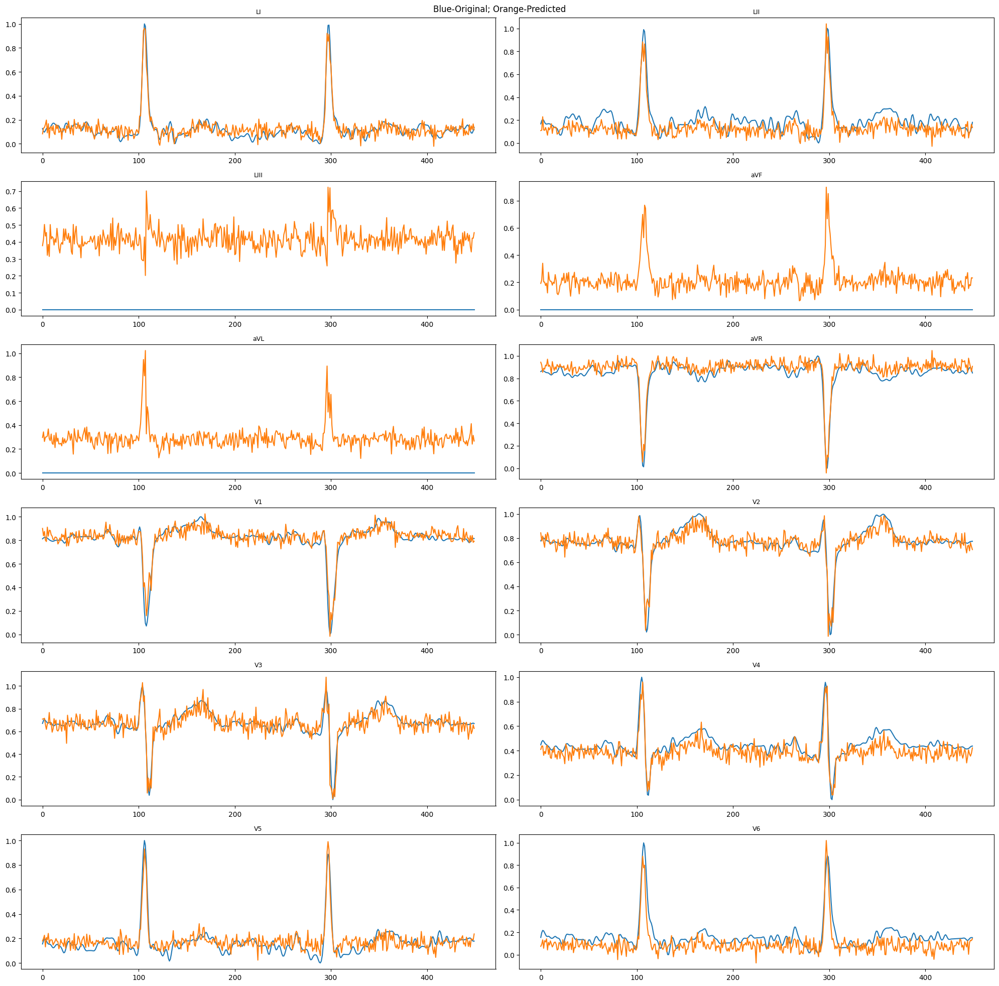

64 1


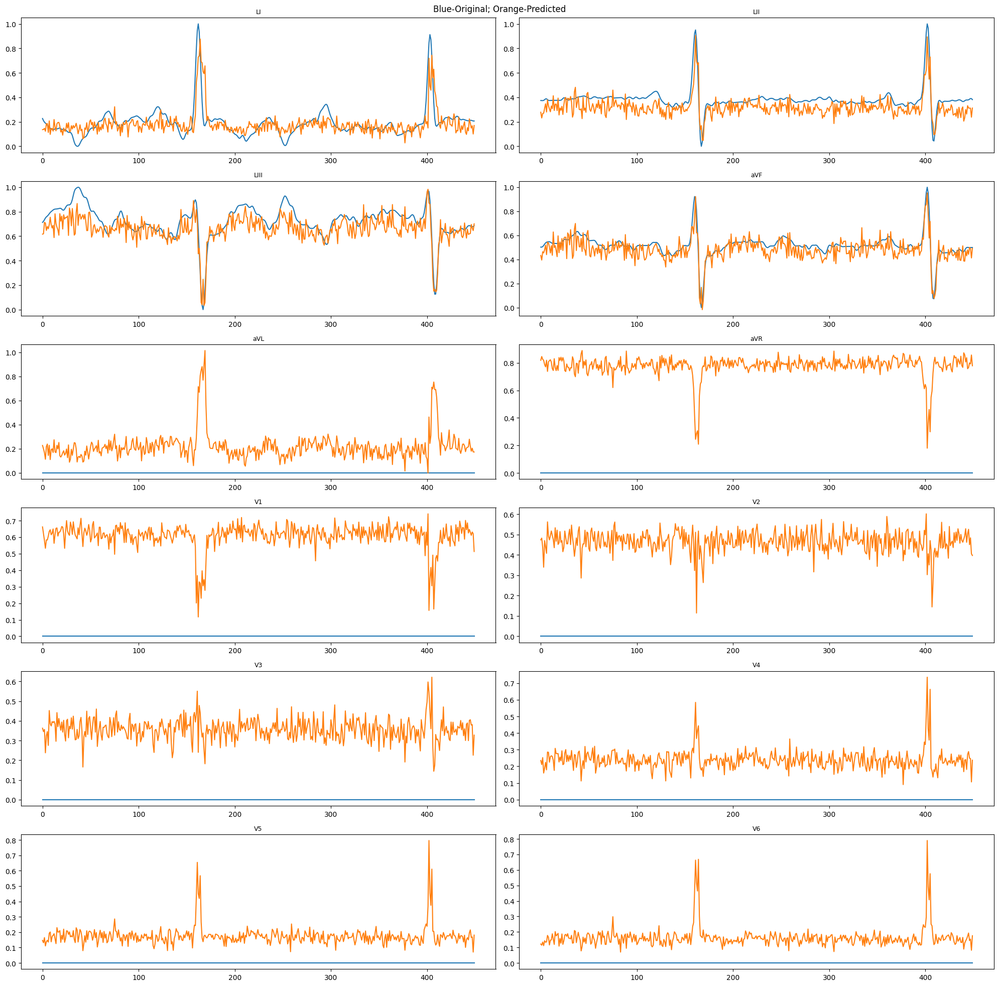

64 1


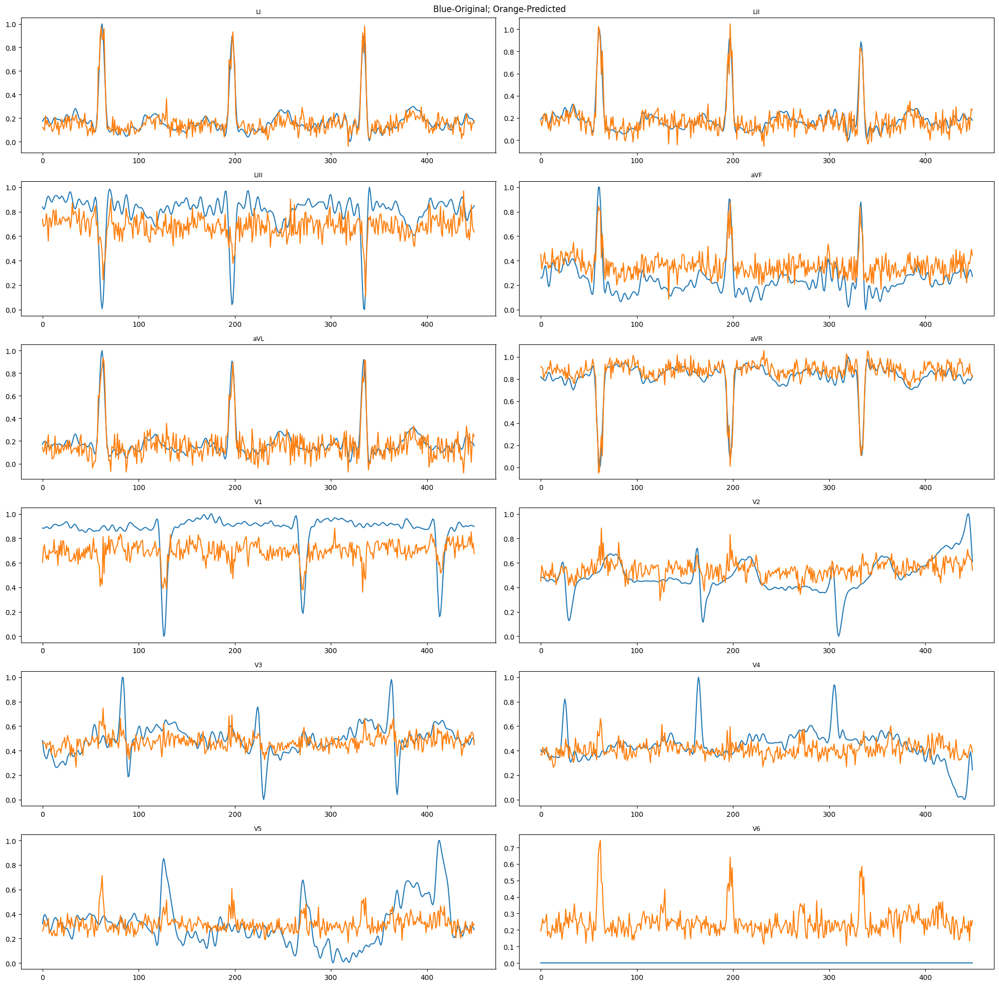

64 1


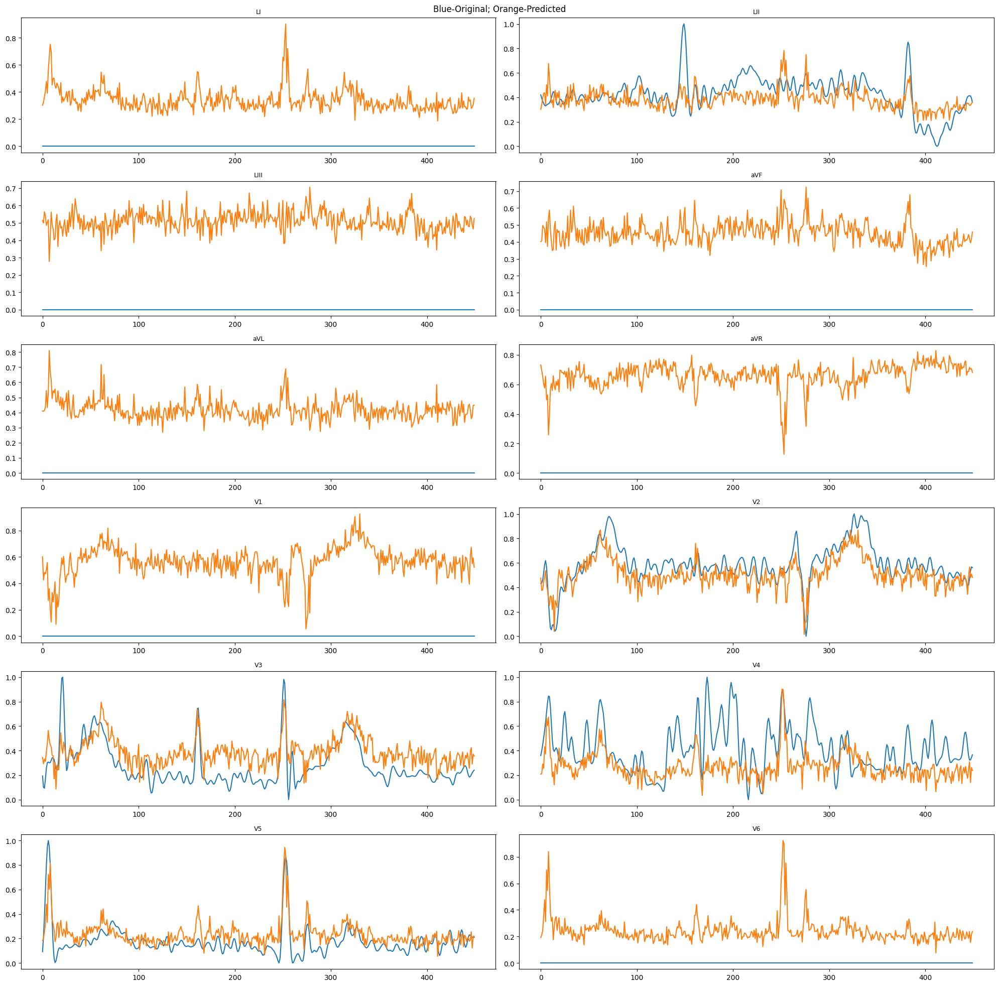

64 1


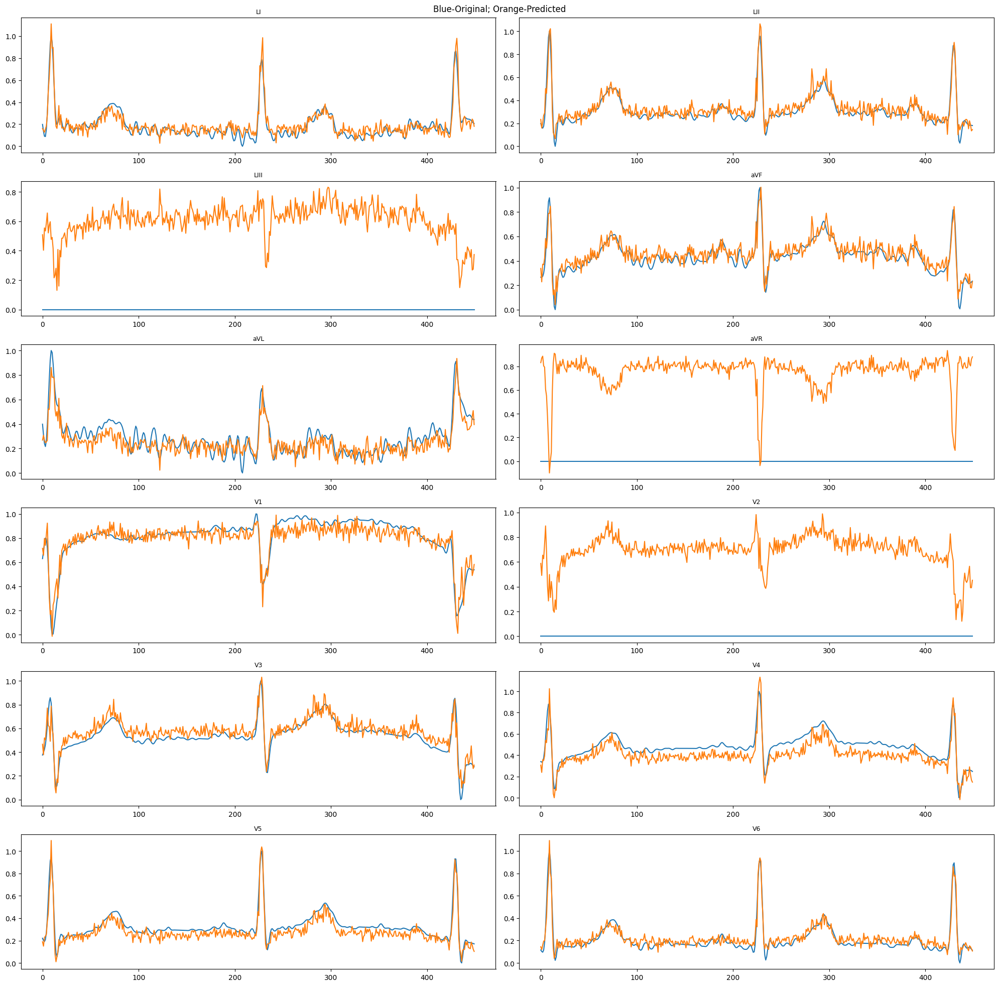

64 1


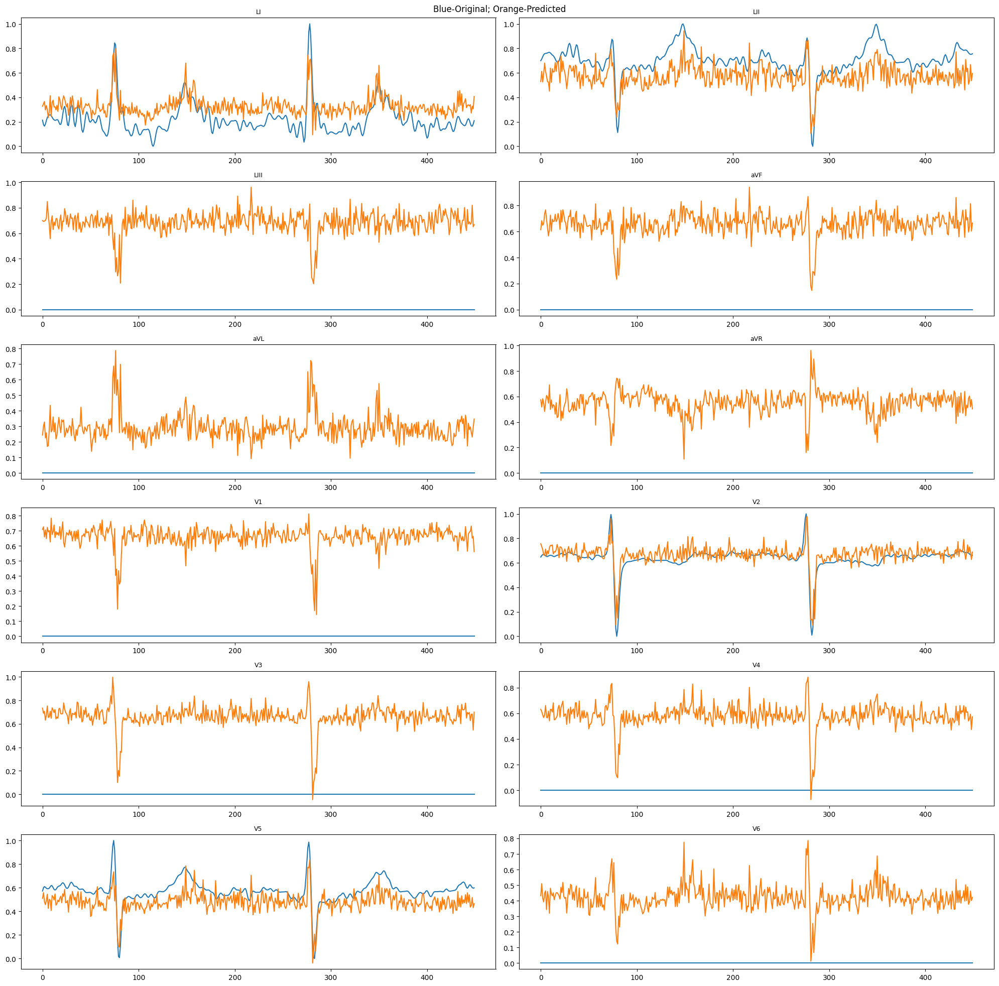

64 1


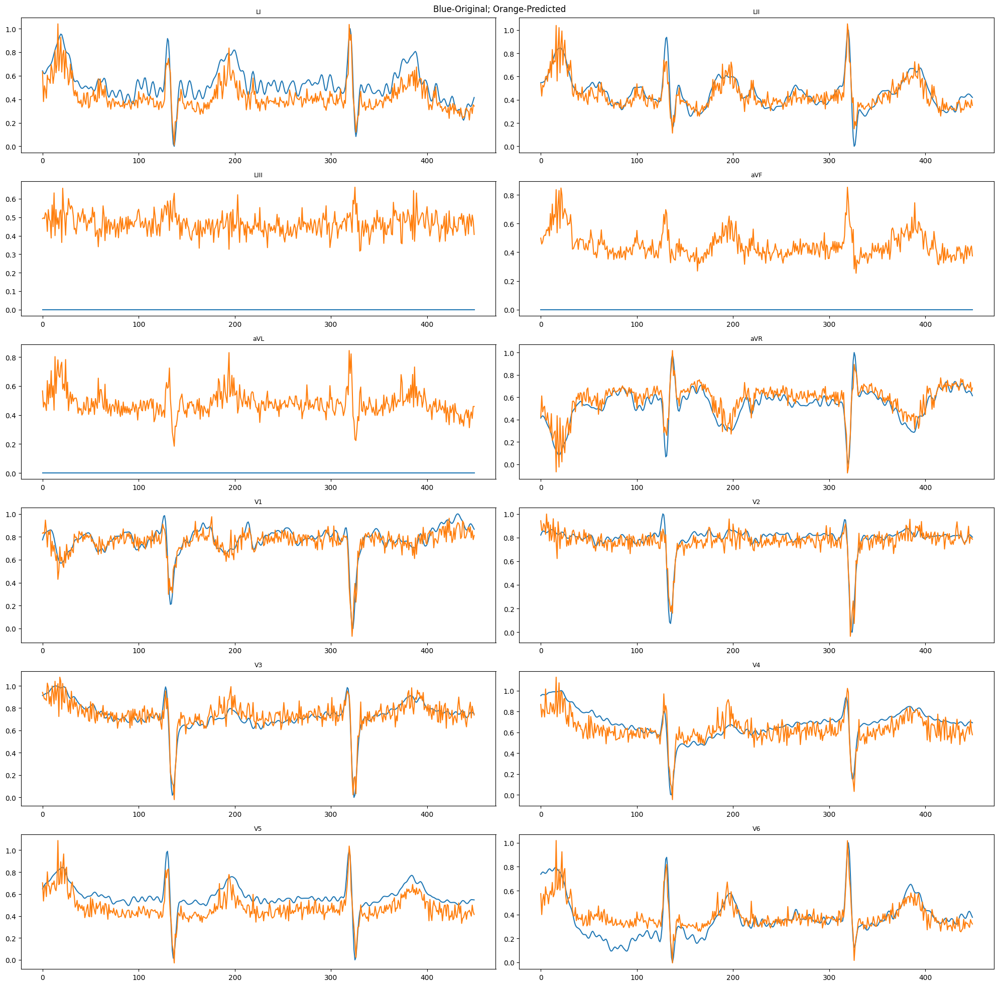

In [170]:
for signal_index in signals_and_MSEs.sort_values('mse')['signal'][:10].values:
    file_name = f'{signal_index}.npy'
    X = np.load(f'{downstream_classification_path}/data/individual-signals/'+file_name,allow_pickle=True)
    X = np.nan_to_num(X, nan=0)
    X = np.expand_dims(X,0)
    plot_signal(X, model_name = 'exp4-base-version-with-train-by-sample-window-450_1695652345.7981088.pt')

### Worst 10

64 1


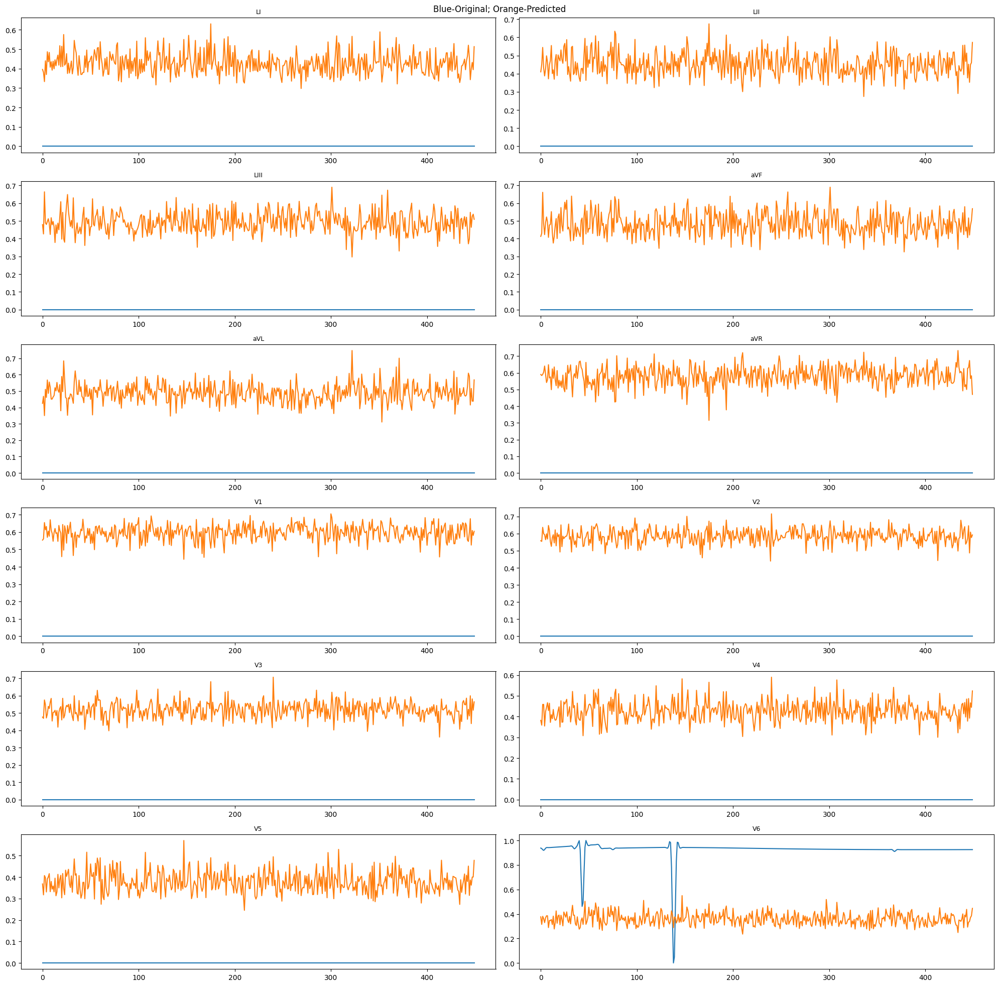

64 1


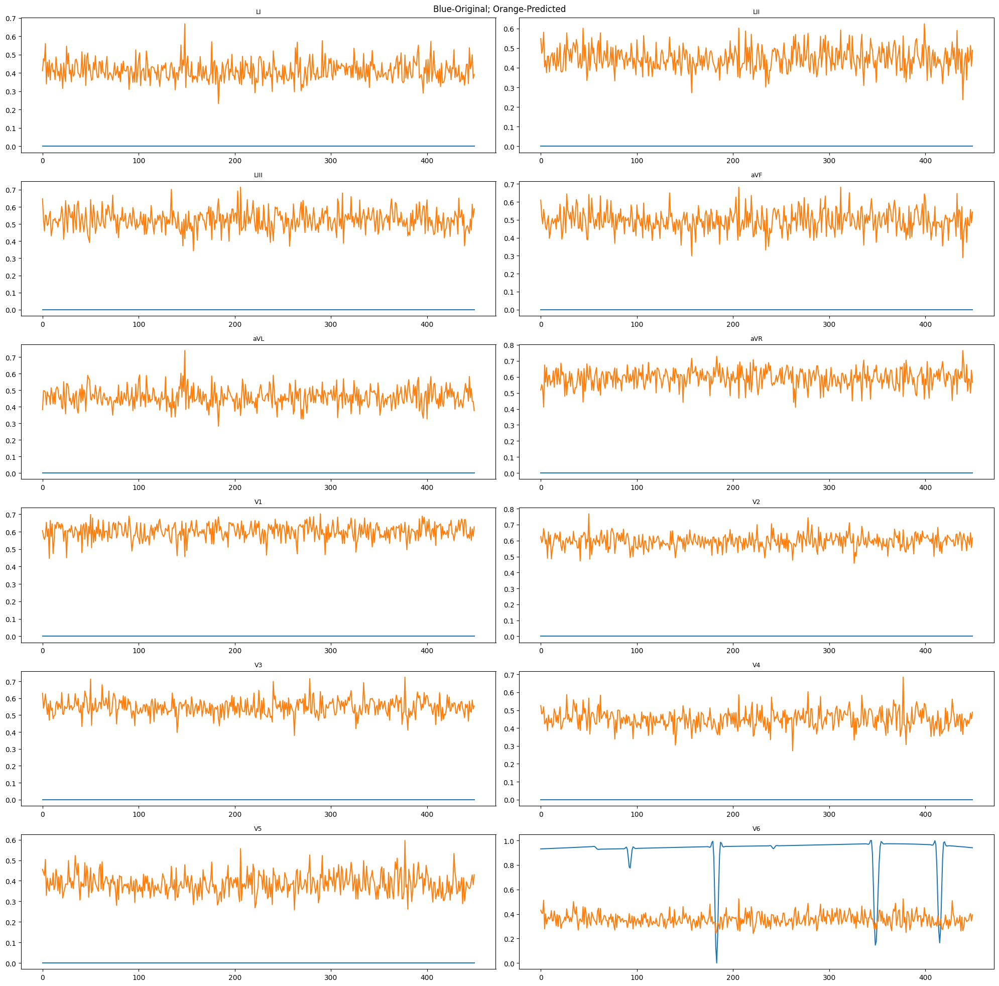

64 1


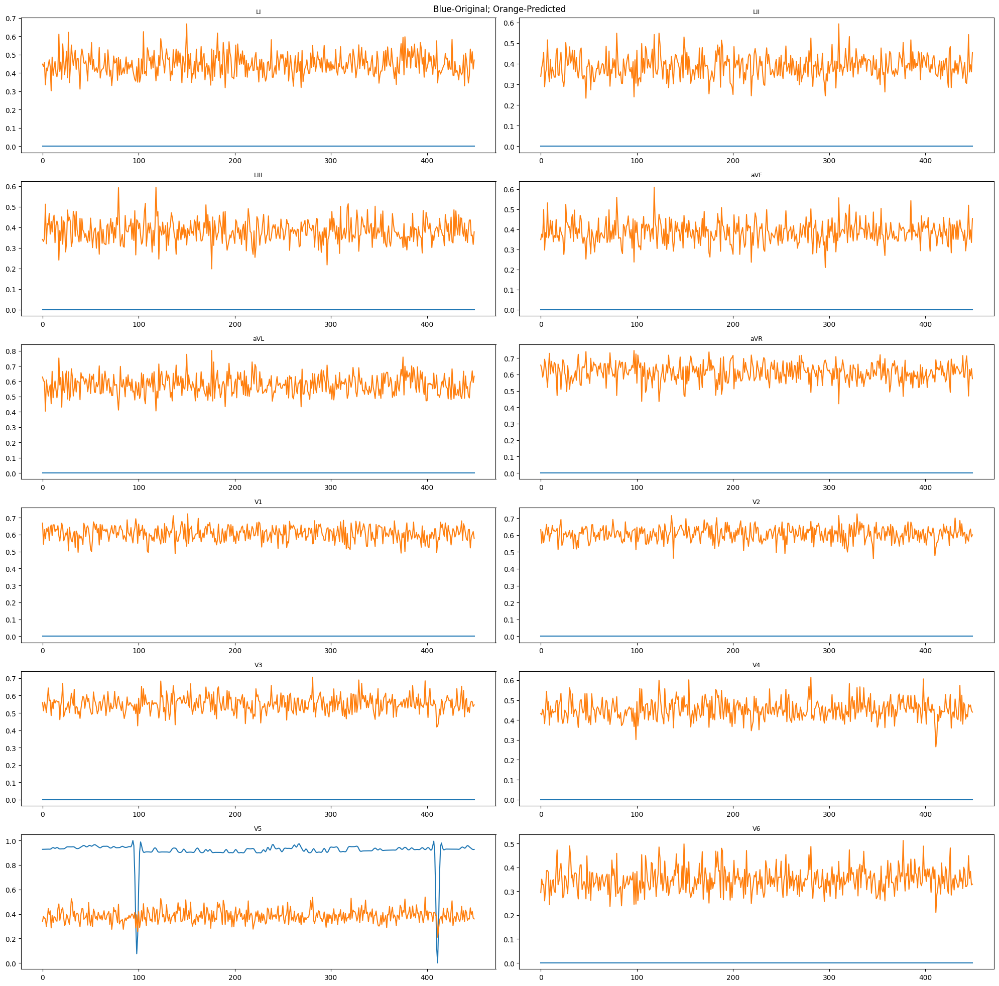

64 1


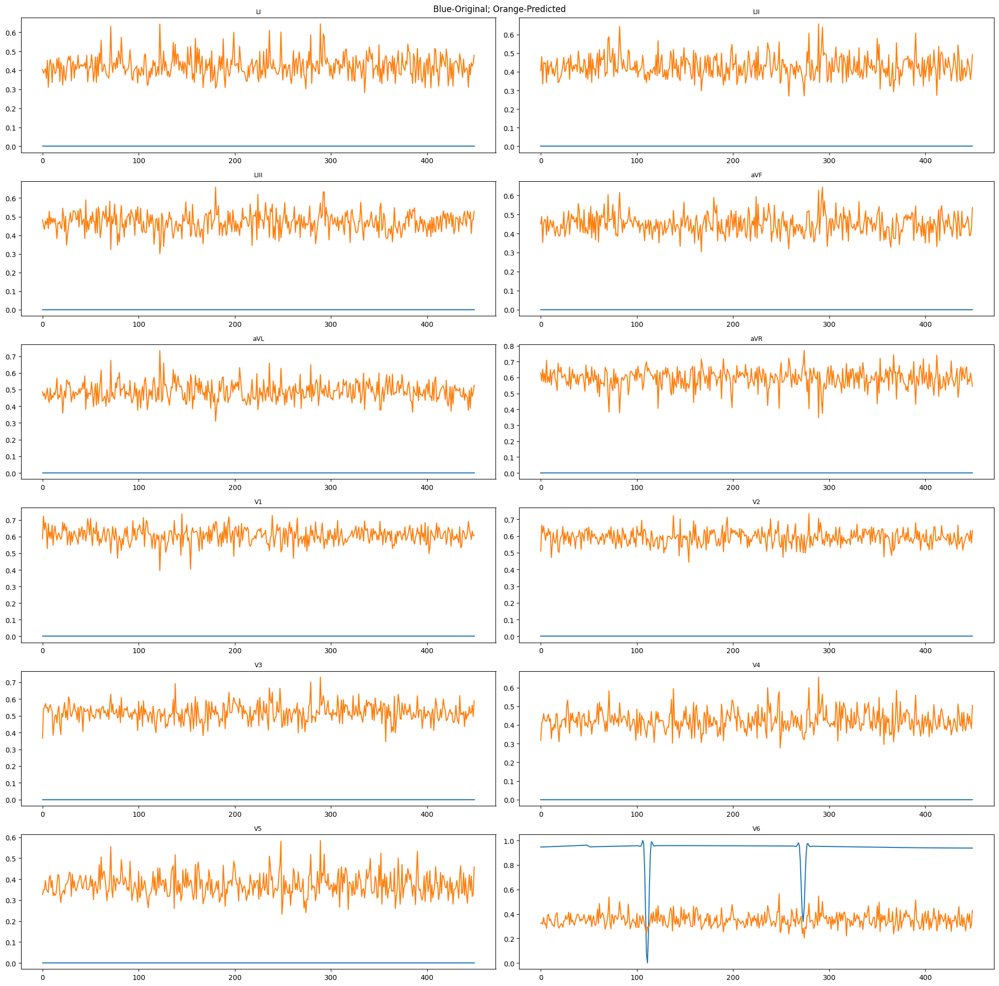

64 1


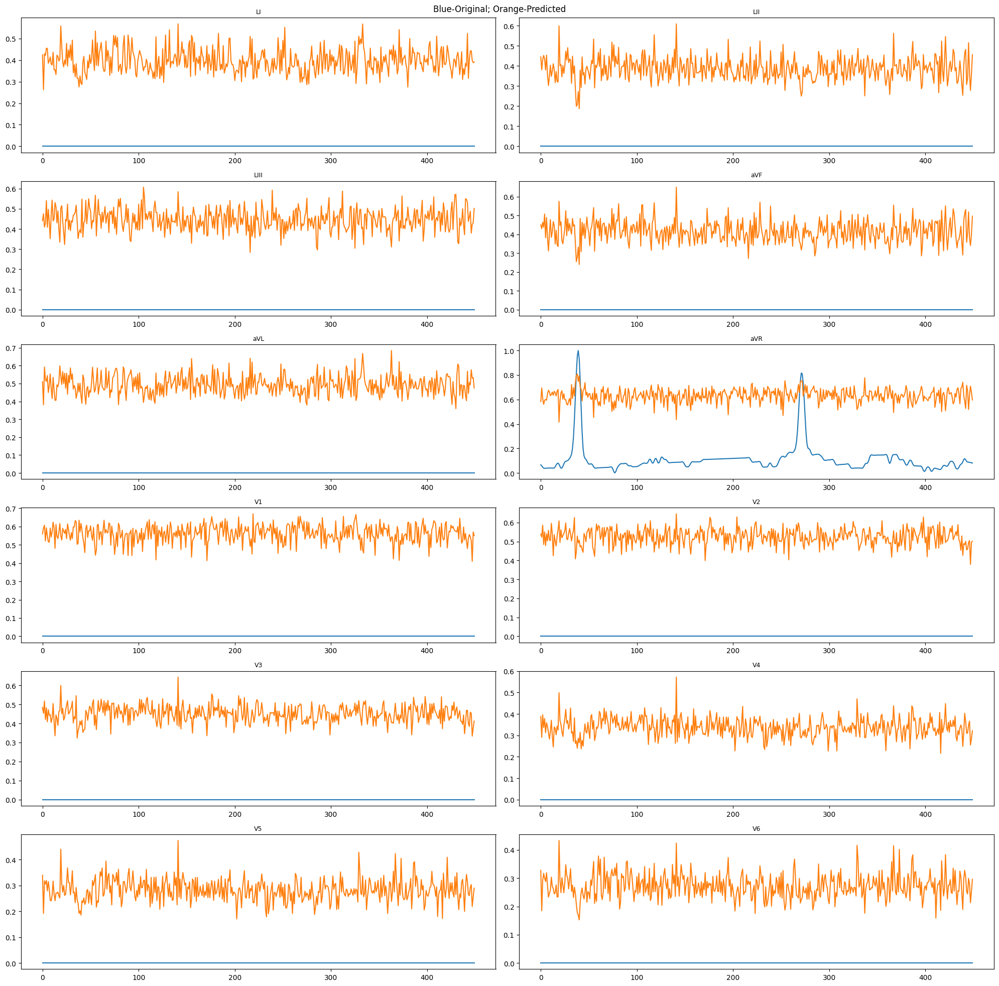

64 1


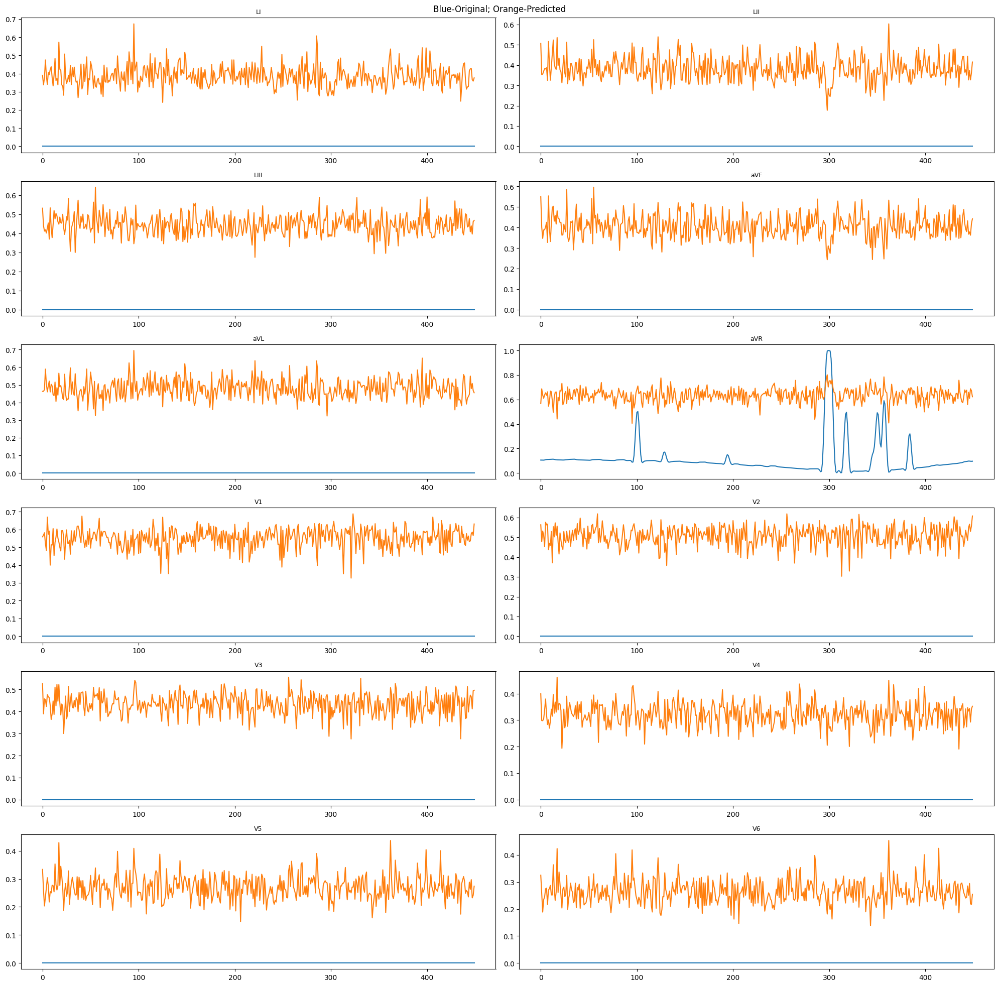

64 1


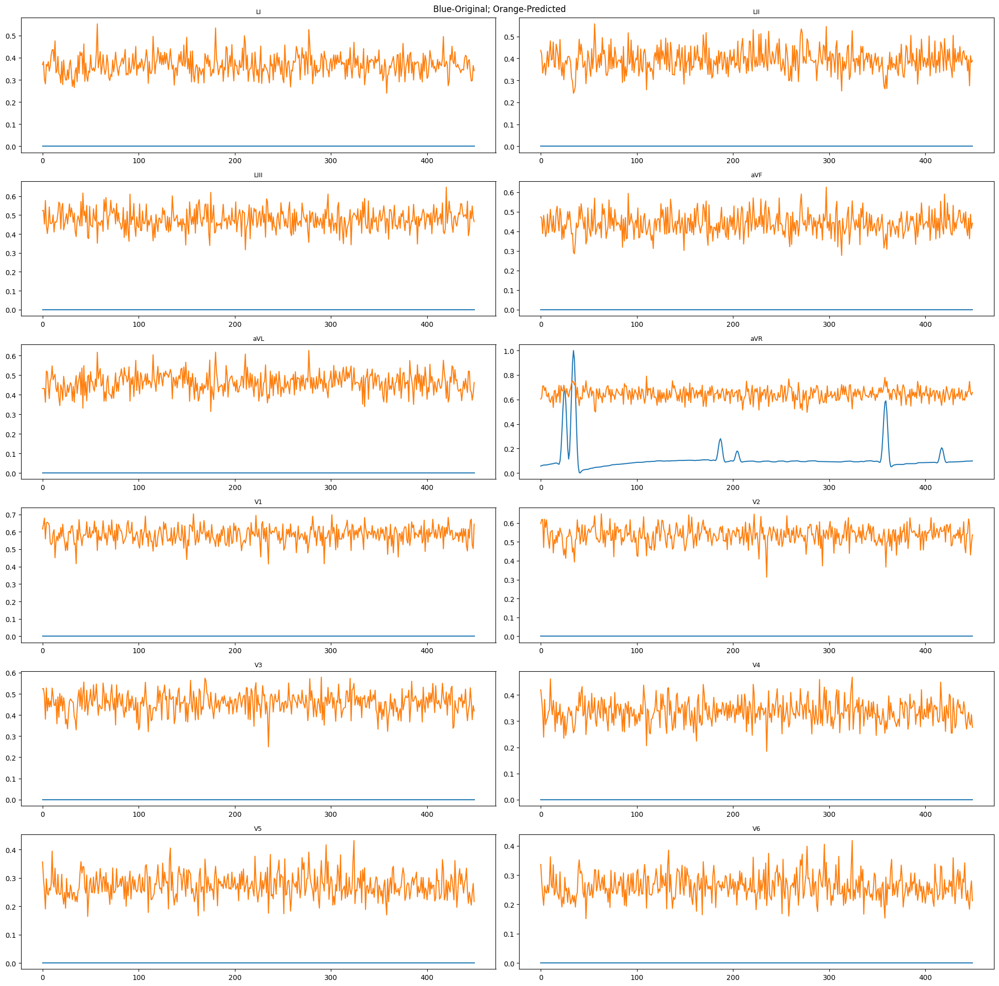

64 1


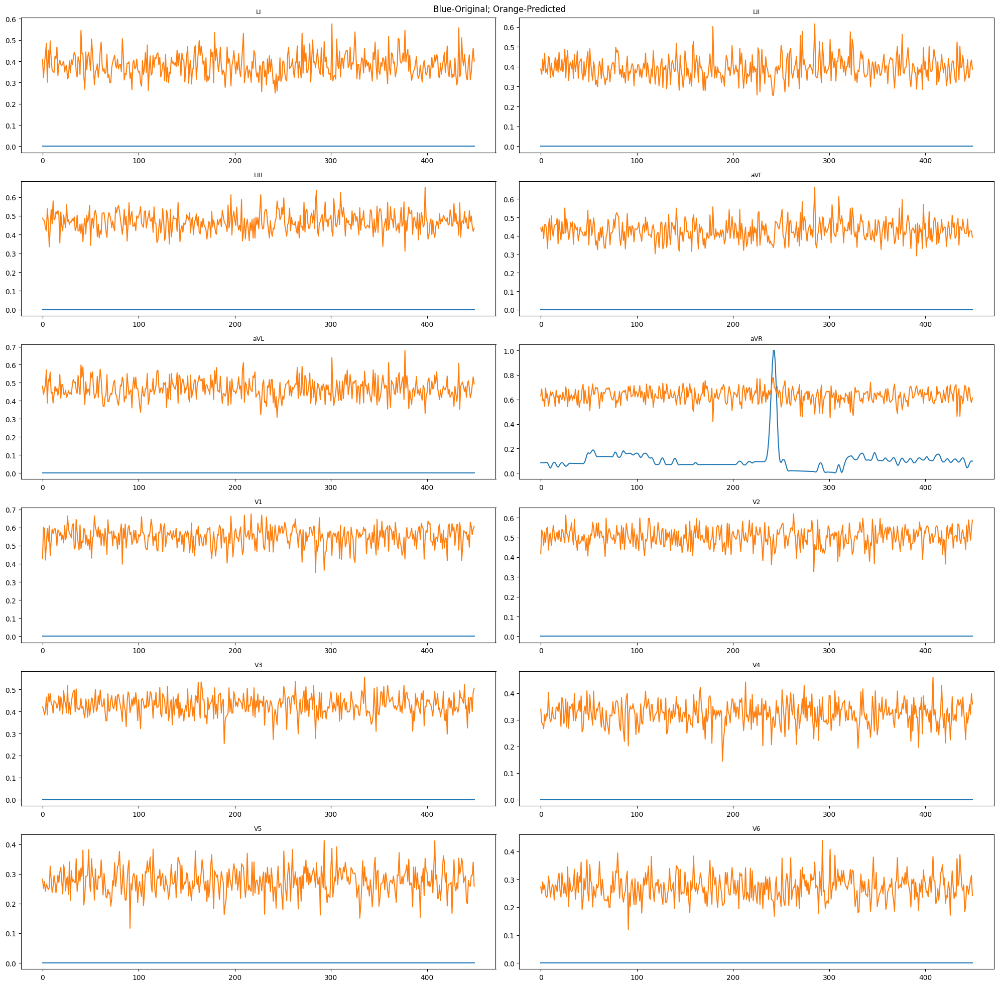

64 1


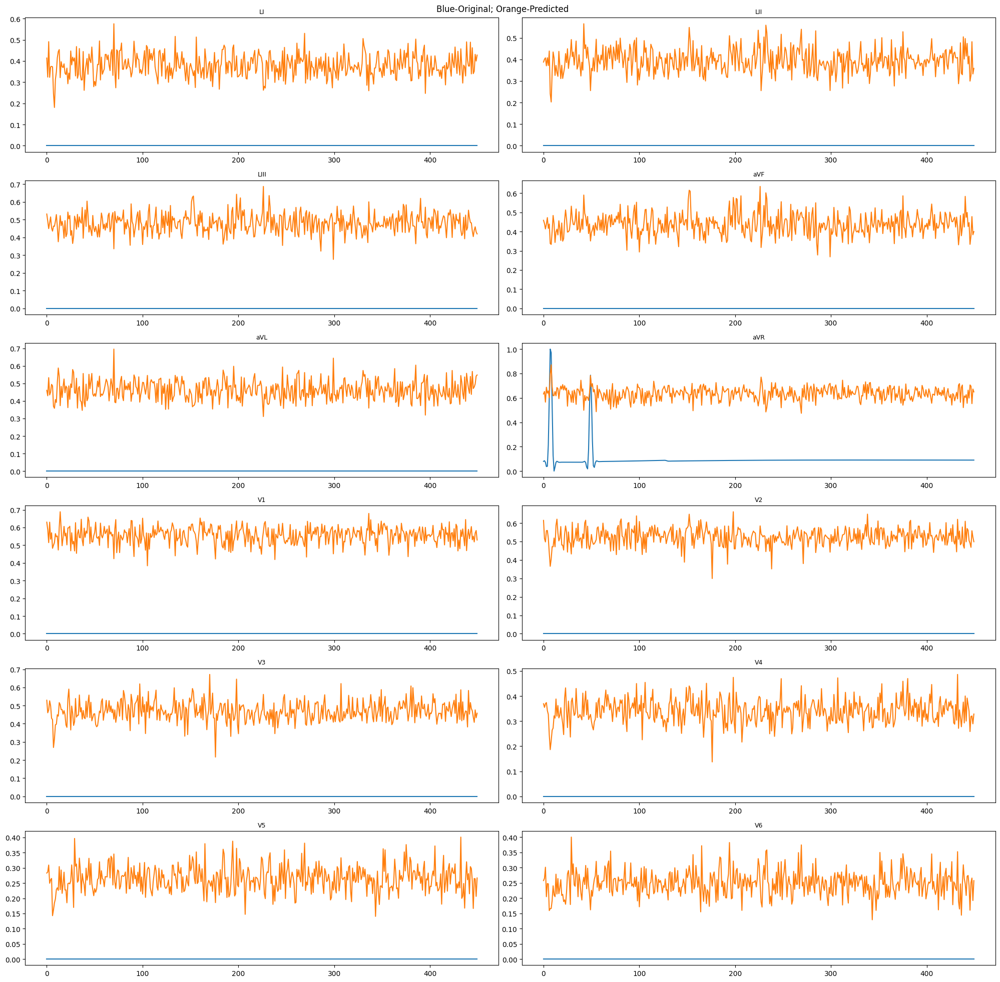

64 1


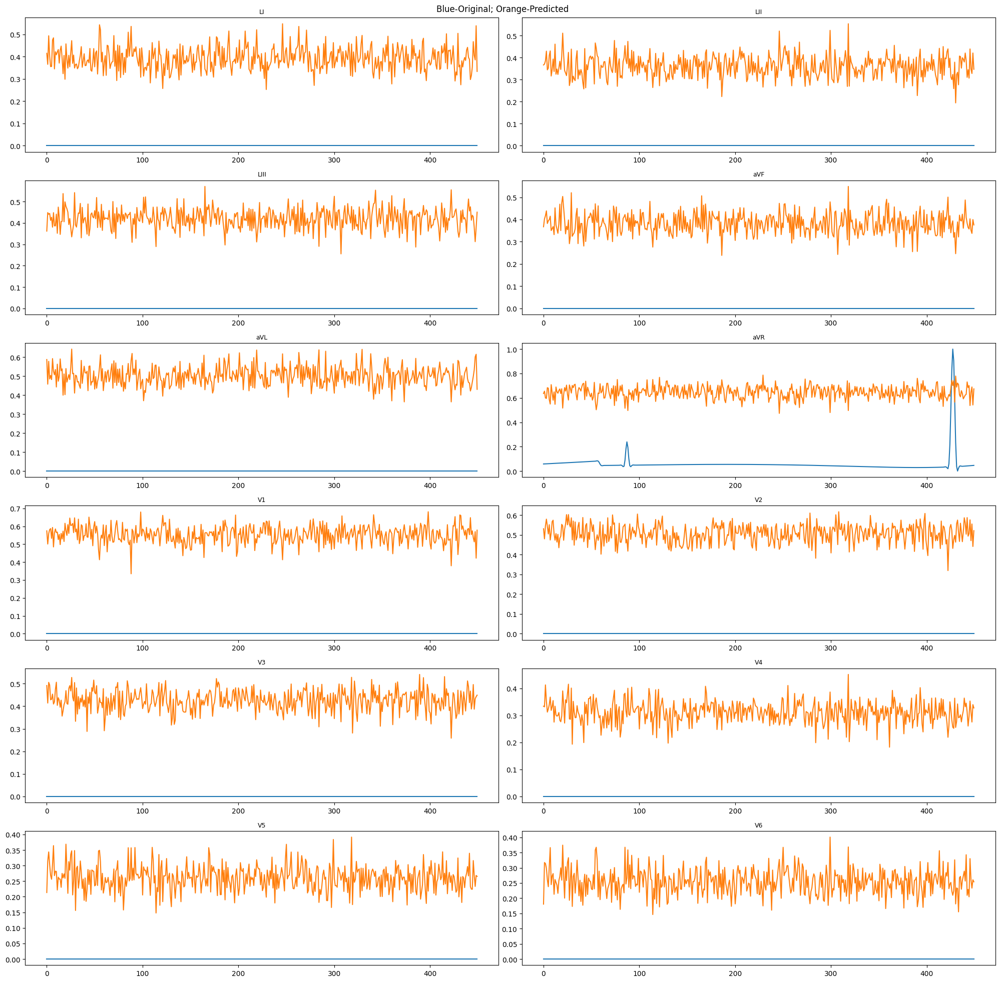

In [171]:
for signal_index in signals_and_MSEs.sort_values('mse')['signal'][-10:].values:
    file_name = f'{signal_index}.npy'
    X = np.load(f'{downstream_classification_path}/data/individual-signals/'+file_name,allow_pickle=True)
    X = np.nan_to_num(X, nan=0)
    X = np.expand_dims(X,0)
    plot_signal(X, model_name = 'exp4-base-version-with-train-by-sample-window-450_1695652345.7981088.pt')

## Bad but not the worst

64 1


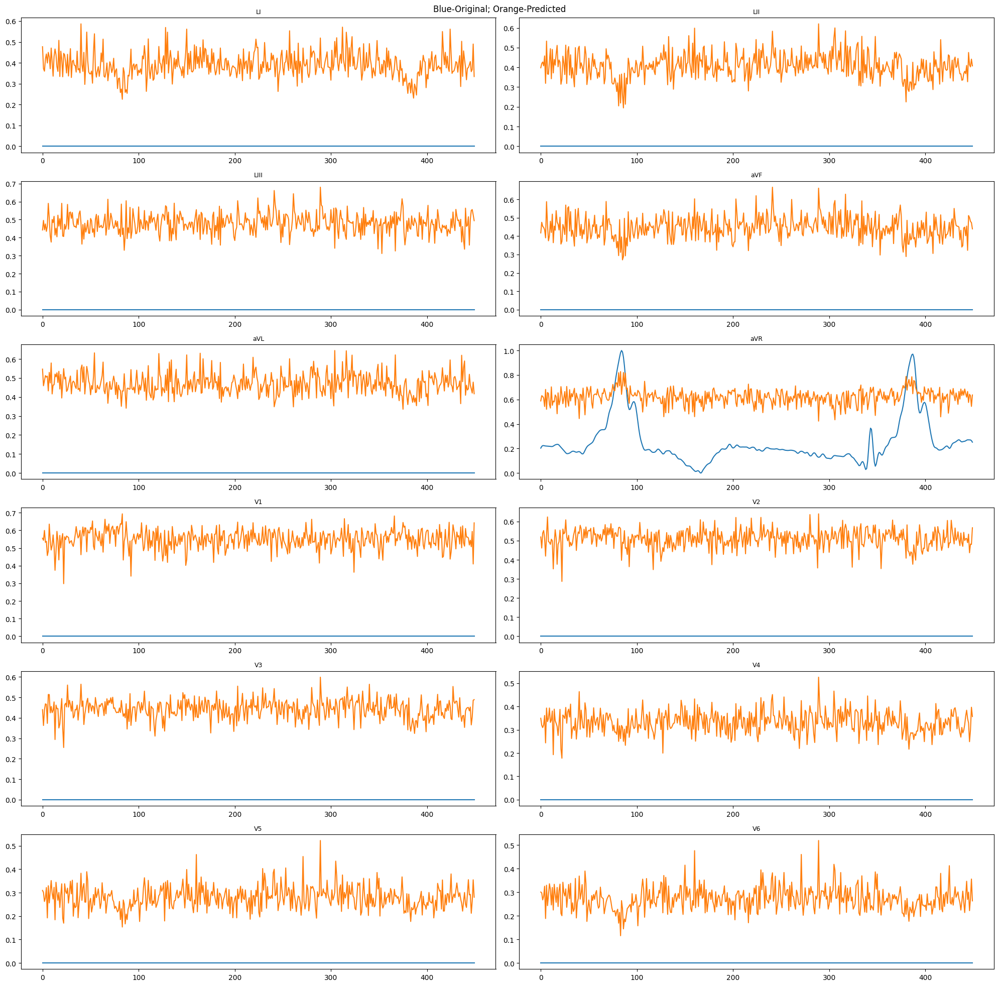

64 1


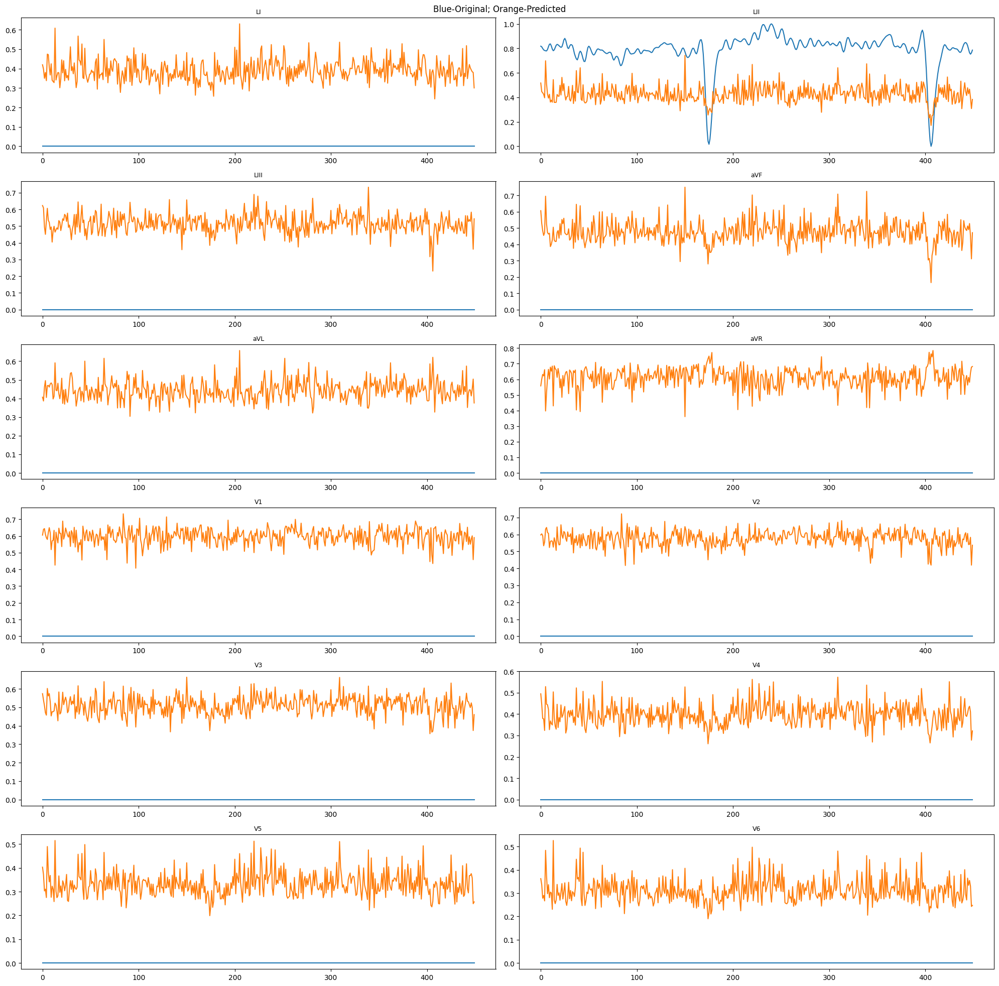

64 1


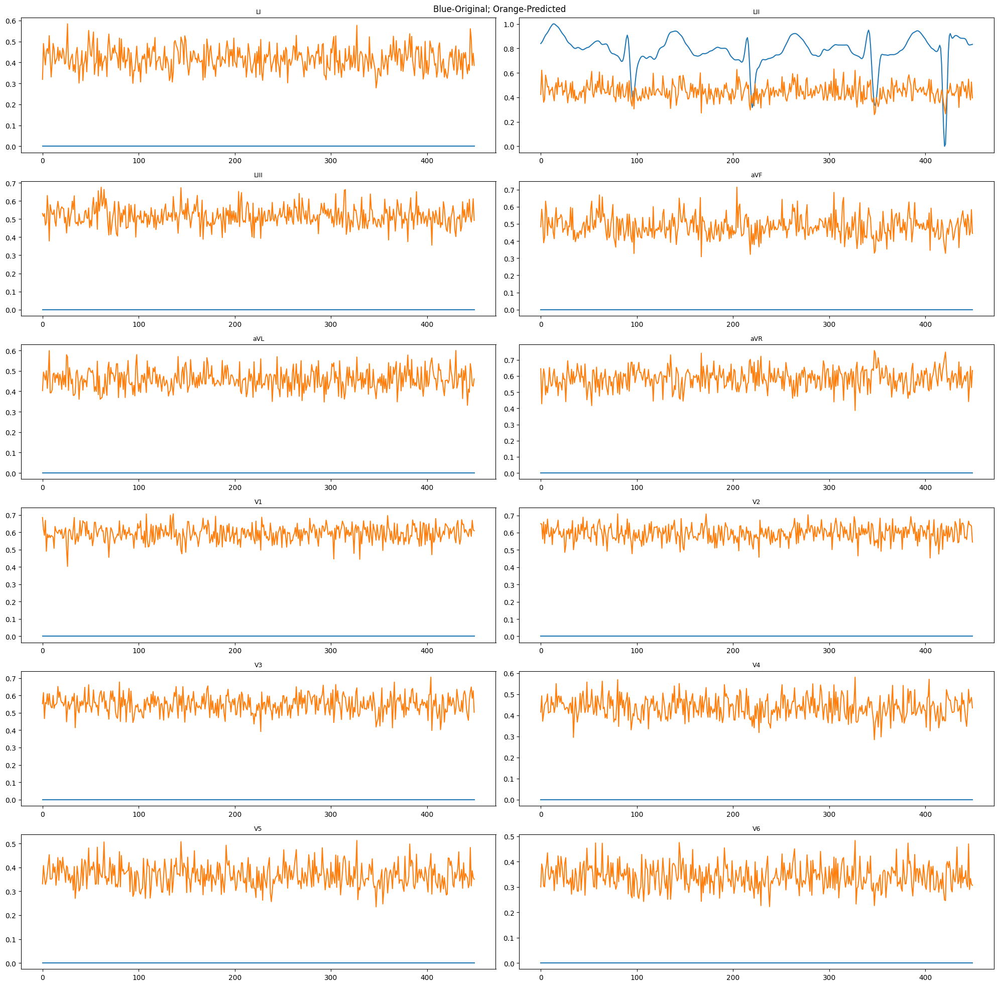

64 1


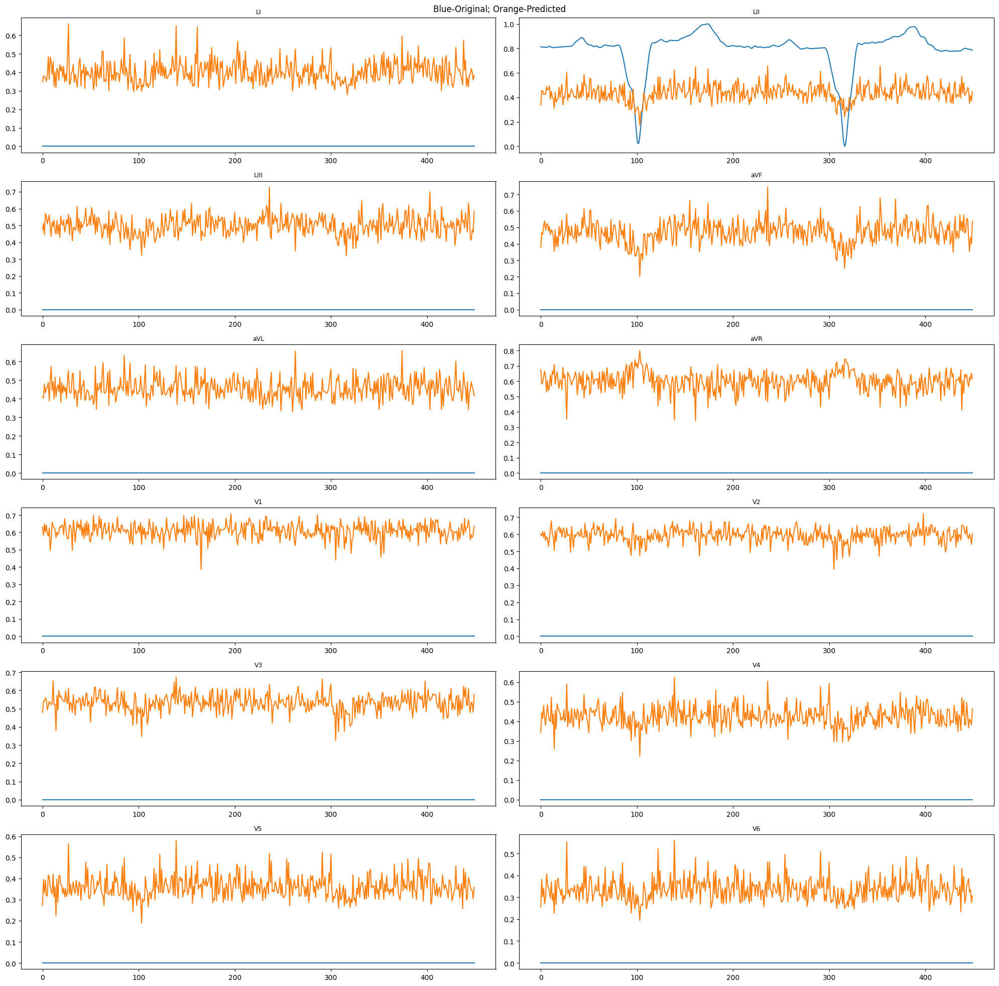

64 1


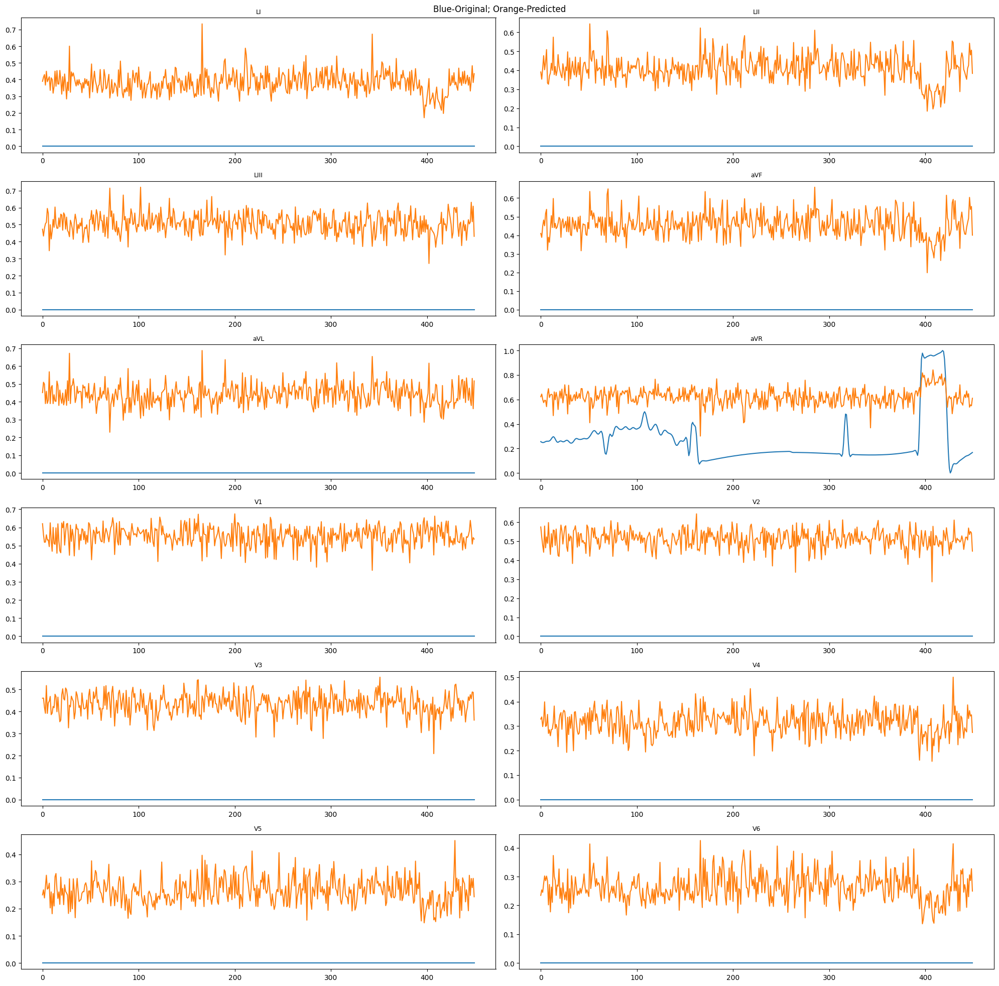

64 1


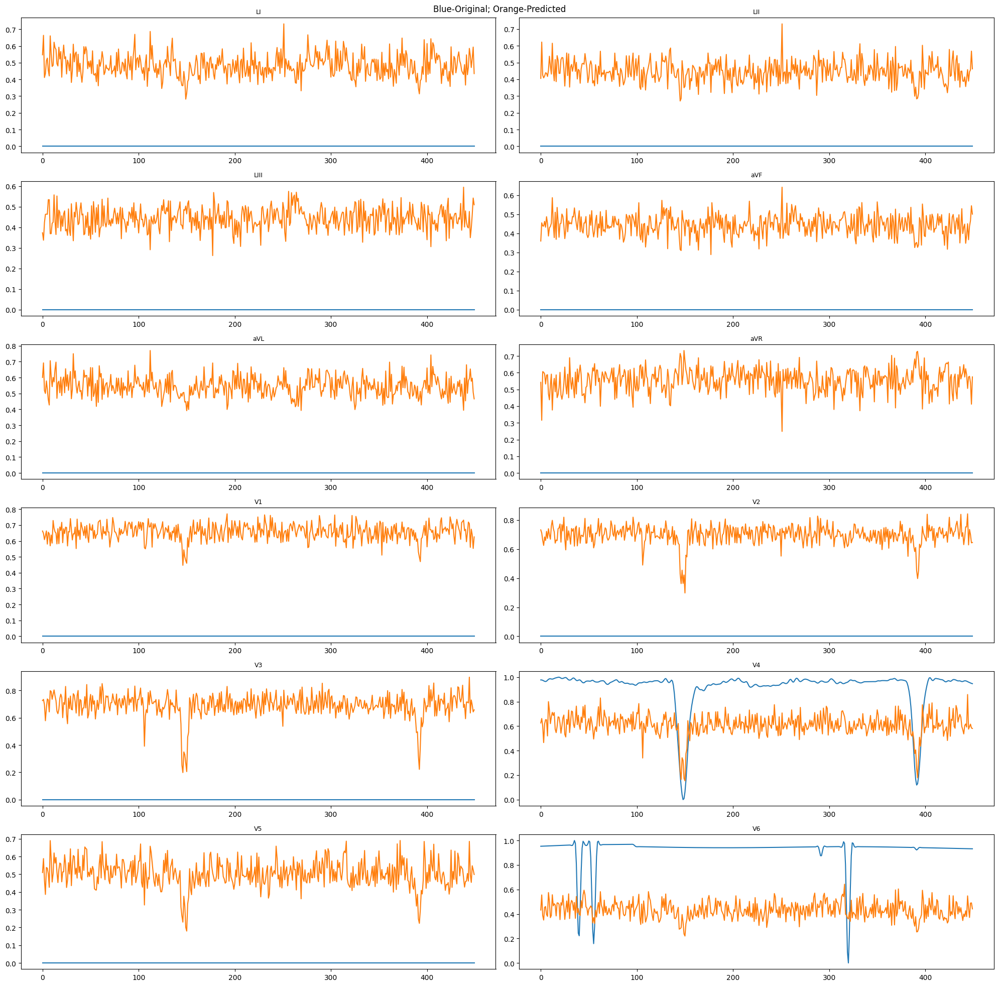

64 1


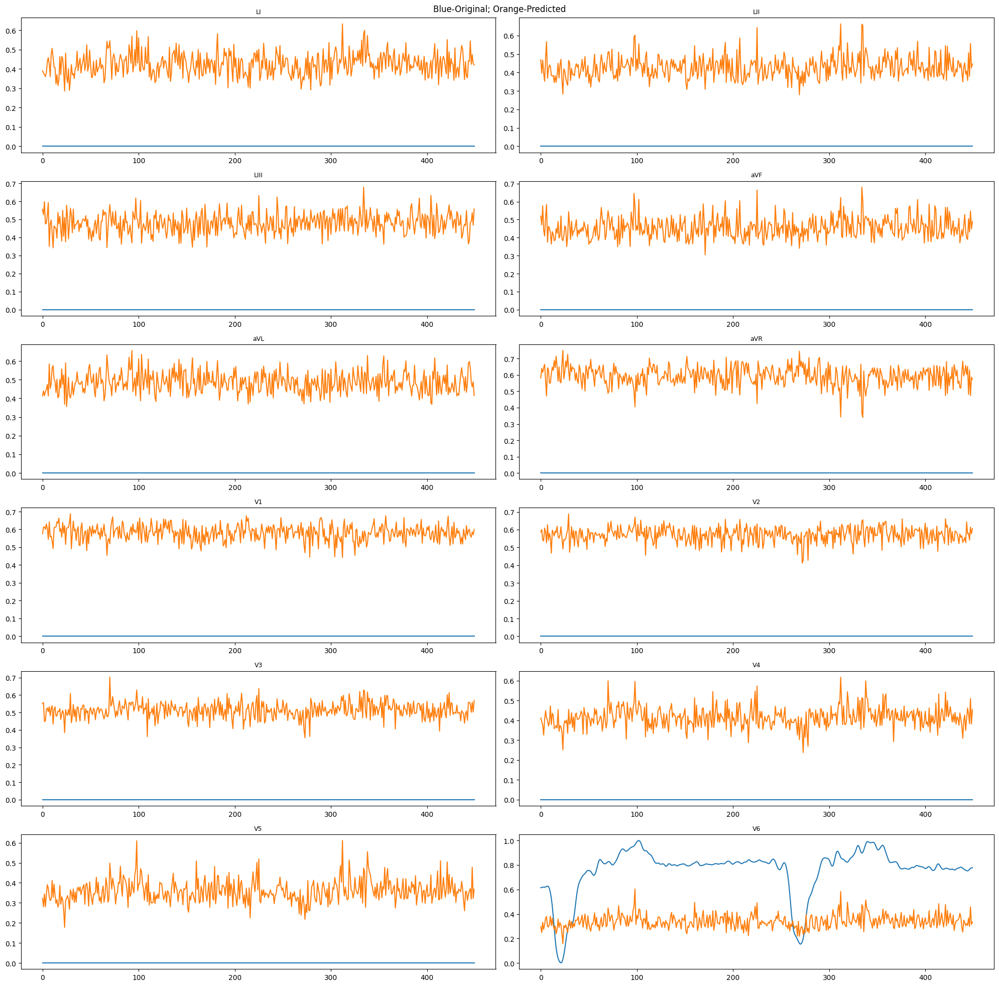

64 1


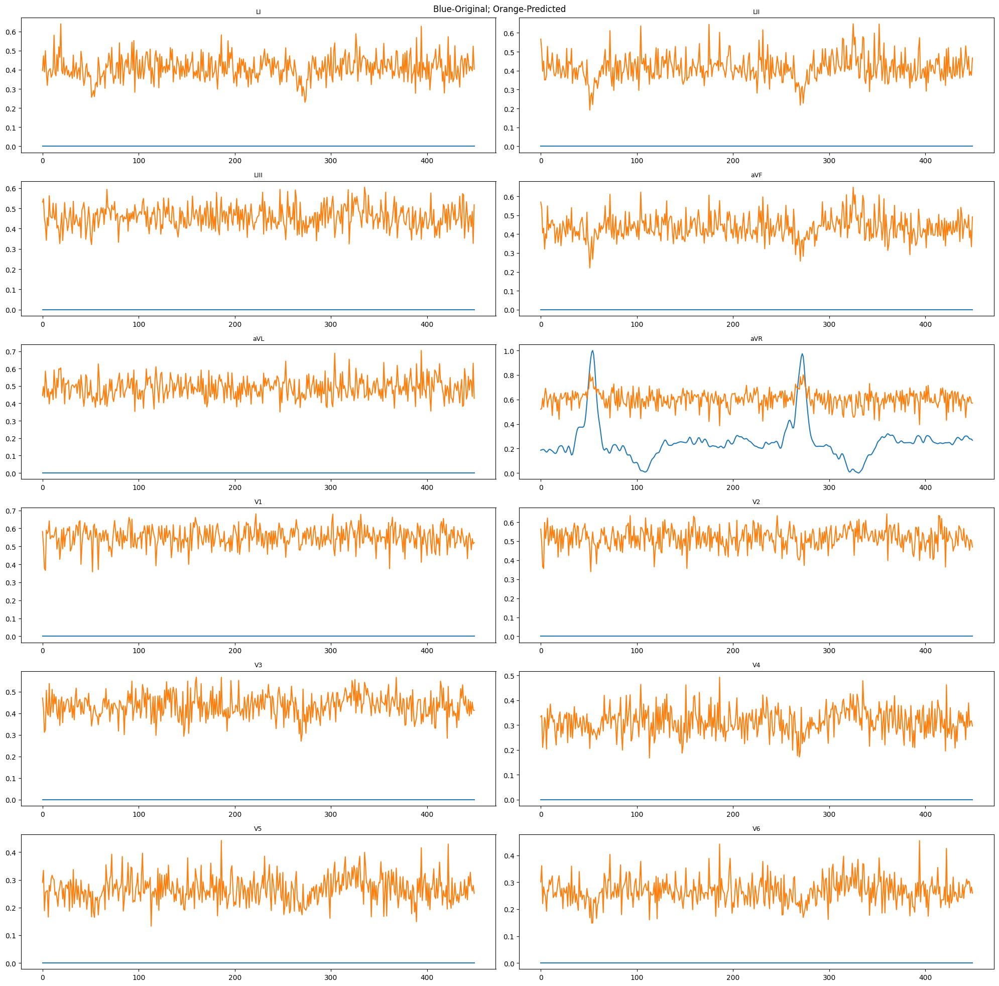

64 1


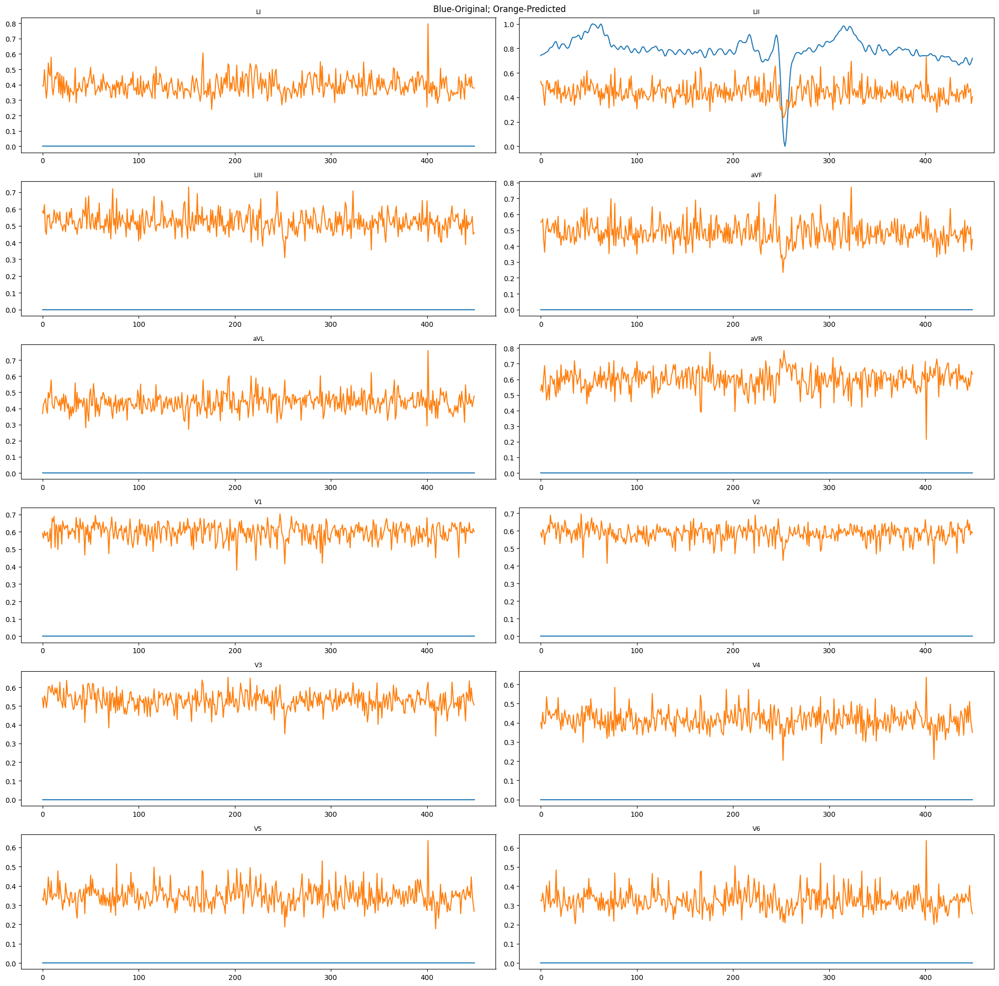

64 1


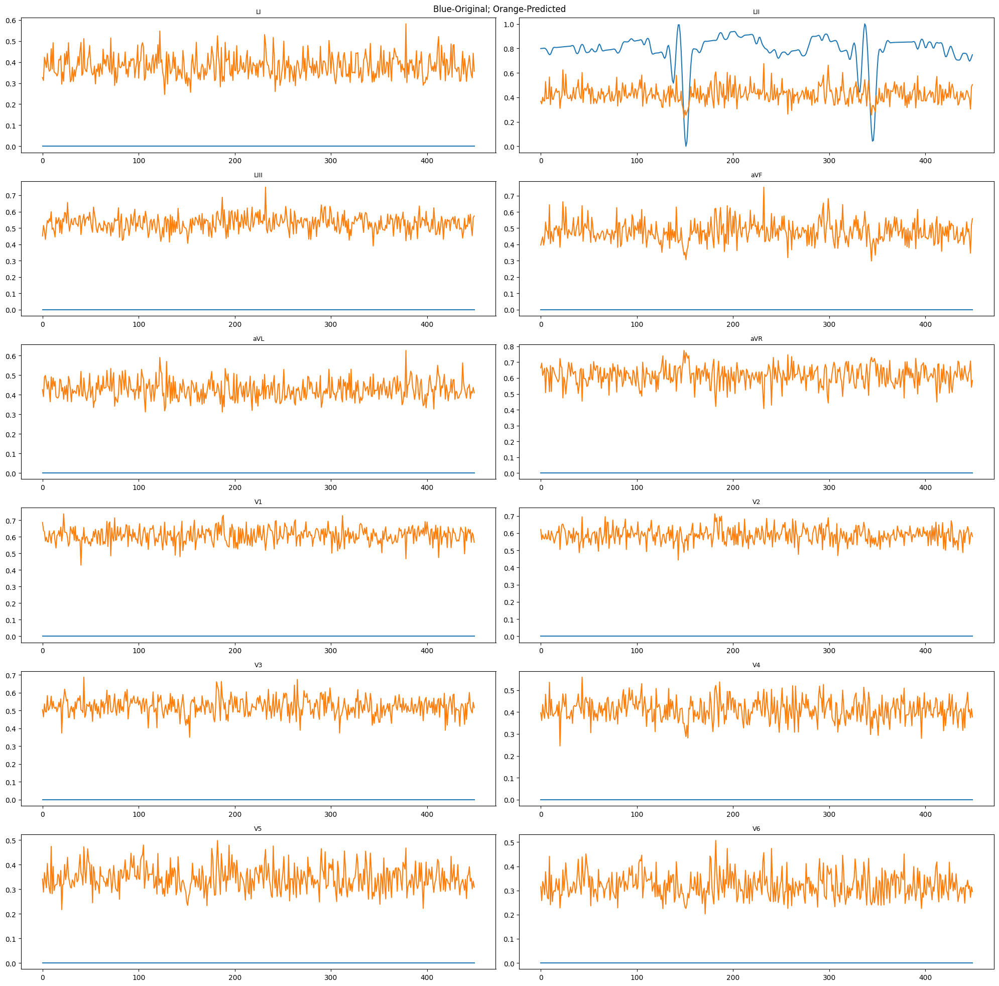

In [175]:
for signal_index in signals_and_MSEs.sort_values('mse')['signal'][-250:-240].values:
    file_name = f'{signal_index}.npy'
    X = np.load(f'{downstream_classification_path}/data/individual-signals/'+file_name,allow_pickle=True)
    X = np.nan_to_num(X, nan=0)
    X = np.expand_dims(X,0)
    plot_signal(X, model_name = 'exp4-base-version-with-train-by-sample-window-450_1695652345.7981088.pt')

In [174]:
signals_and_MSEs.sort_values('mse')['signal'][-250:240]

Series([], Name: signal, dtype: int64)